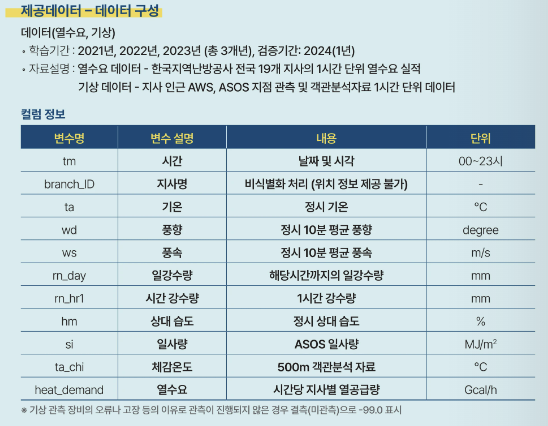

## 패키지 & 데이터 로드

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# pip install missingno
import missingno

In [3]:
import matplotlib.pyplot as plt
import matplotlib.font_manager as fm
import seaborn as sns

# 한글 폰트 설정 (Windows 기준)
plt.rcParams['font.family'] = 'Malgun Gothic'

# 마이너스 깨짐 방지
plt.rcParams['axes.unicode_minus'] = False


In [21]:
heat = pd.read_csv("../data/train_heat.csv", index_col=0)
heat.head()

,train_heat.tm,train_heat.branch_id,train_heat.ta,train_heat.wd,train_heat.ws,train_heat.rn_day,train_heat.rn_hr1,train_heat.hm,train_heat.si,train_heat.ta_chi,train_heat.heat_demand
1,2021010101,A,-10.1,78.3,0.5,0.0,0.0,68.2,-99.0,-8.2,281
2,2021010102,A,-10.2,71.9,0.6,0.0,0.0,69.9,-99.0,-8.6,262
3,2021010103,A,-10.0,360.0,0.0,0.0,0.0,69.2,-99.0,-8.8,266
4,2021010104,A,-9.3,155.9,0.5,0.0,0.0,65.0,-99.0,-8.9,285
5,2021010105,A,-9.0,74.3,1.9,0.0,0.0,63.5,-99.0,-9.2,283


In [22]:
# 컬럼명에서 train_heat. 제거
heat.columns = heat.columns.str.replace("train_heat.", "", regex=False)
heat.head(2)

,tm,branch_id,ta,wd,ws,rn_day,rn_hr1,hm,si,ta_chi,heat_demand
1,2021010101,A,-10.1,78.3,0.5,0.0,0.0,68.2,-99.0,-8.2,281
2,2021010102,A,-10.2,71.9,0.6,0.0,0.0,69.9,-99.0,-8.6,262


In [23]:
heat.shape
# 499301개의 데이터, 11개의 feature

(499301, 11)

In [24]:
heat.info()

<class 'pandas.core.frame.DataFrame'>
Index: 499301 entries, 1 to 499301
Data columns (total 11 columns):
 #   Column       Non-Null Count   Dtype  
---  ------       --------------   -----  
 0   tm           499301 non-null  int64  
 1   branch_id    499301 non-null  object 
 2   ta           499301 non-null  float64
 3   wd           499301 non-null  float64
 4   ws           499301 non-null  float64
 5   rn_day       499301 non-null  float64
 6   rn_hr1       499301 non-null  float64
 7   hm           499301 non-null  float64
 8   si           499301 non-null  float64
 9   ta_chi       499301 non-null  float64
 10  heat_demand  499301 non-null  int64  
dtypes: float64(8), int64(2), object(1)
memory usage: 45.7+ MB


In [25]:
# 날짜 데이터를 데이트타임으로 변경
heat['tm'] = pd.to_datetime(heat['tm'].astype(str), format="%Y%m%d%H")

In [26]:
heat['tm'] # 2021-01-01부터 2023-12-31까지의 데이터

1        2021-01-01 01:00:00
2        2021-01-01 02:00:00
3        2021-01-01 03:00:00
4        2021-01-01 04:00:00
5        2021-01-01 05:00:00
                 ...        
499297   2023-12-31 19:00:00
499298   2023-12-31 20:00:00
499299   2023-12-31 21:00:00
499300   2023-12-31 22:00:00
499301   2023-12-31 23:00:00
Name: tm, Length: 499301, dtype: datetime64[ns]

In [27]:
heat['year'] = heat['tm'].dt.year
heat['month'] = heat['tm'].dt.month
heat['day'] = heat['tm'].dt.day
heat['hour'] = heat['tm'].dt.hour

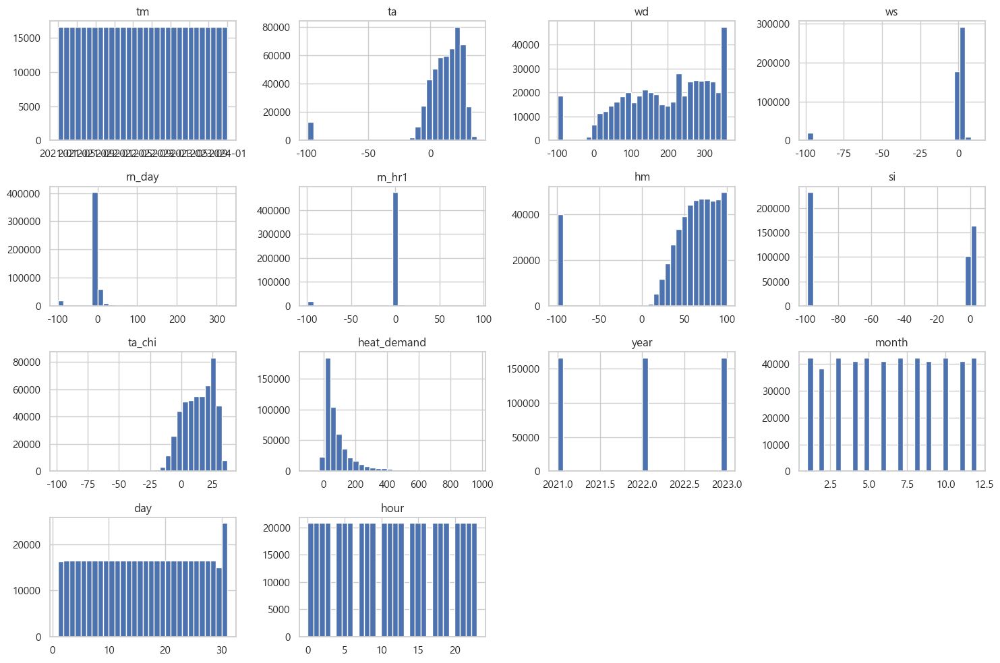

In [94]:
heat.hist(figsize=(15, 10), bins=30)
plt.tight_layout()
plt.show()

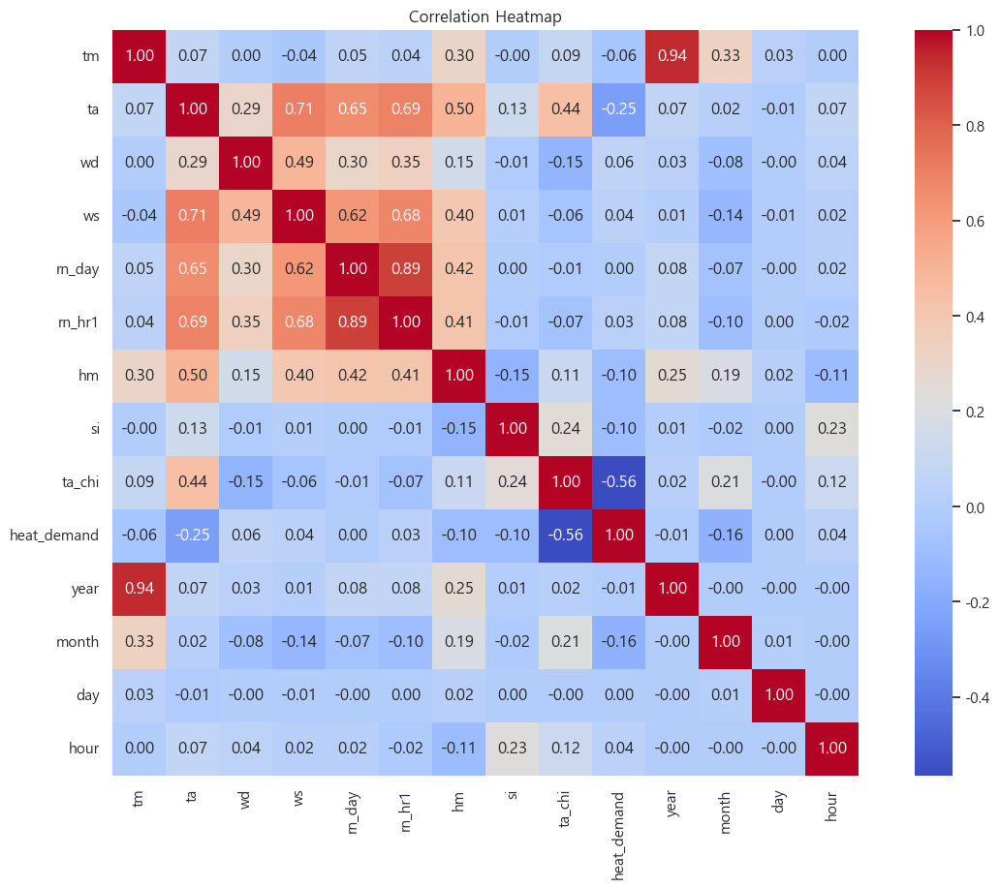

In [95]:
corr = heat.drop('branch_id',axis=1).corr()
plt.figure(figsize=(15, 10))
plt.title('Correlation Heatmap')
sns.heatmap(corr, annot=True, fmt='.2f', cmap='coolwarm', cbar=True, square=True)
plt.show()

## 결측치 확인
- -99로 저장되어 있음

In [96]:
len(heat[heat.isin([-99]).any(axis=1)])
# 263069개의 결측치 -> na로 대체할래

263069

In [28]:
heat = heat.replace(-99, np.nan)

In [98]:
heat.isnull().sum()

tm                  0
branch_id           0
ta              12997
wd              18815
ws              18815
rn_day          18626
rn_hr1          19154
hm              39717
si             232922
ta_chi             20
heat_demand        23
year                0
month               0
day                 0
hour                0
dtype: int64

In [99]:
# 비율로 확인
heat.isnull().mean()

tm             0.000000
branch_id      0.000000
ta             0.026030
wd             0.037683
ws             0.037683
rn_day         0.037304
rn_hr1         0.038362
hm             0.079545
si             0.466496
ta_chi         0.000040
heat_demand    0.000046
year           0.000000
month          0.000000
day            0.000000
hour           0.000000
dtype: float64

- si에 유난히 결측치 많음!!

<Axes: >

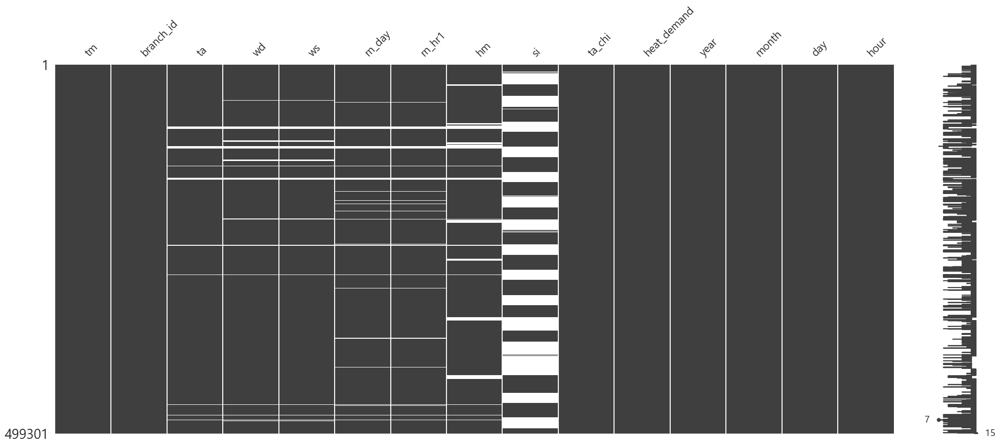

In [100]:
# 시각화로 확인
missingno.matrix(heat)

In [87]:
# 결측치가 한 번에 있는 경우가 되게 많다!
cols = ['ta', 'wd', 'ws', 'rn_day', 'rn_hr1', 'hm']
# 모든 컬럼이 동시에 결측인 행
all_nan_rows = heat[heat[cols].isnull().all(axis=1)]
print(len(all_nan_rows))

# 12924개가 동시에 결측치임!

12924


In [ ]:
heat['many_nan'] = (heat[cols].isnull().sum(axis=1) >= 5).astype(int)
# 연속 구간 라벨링
heat['block'] = (heat['many_nan'].diff(1) != 0).cumsum()
# 연속 구간 길이 계산
block_sizes = heat.groupby('block')['many_nan'].sum()
# 2개 이상 연속된 구간의 block 번호
long_blocks = block_sizes[block_sizes >= 2].index
# 해당 구간만 추출
consecutive_many_nan = heat[heat['block'].isin(long_blocks) & (heat['many_nan'] == 1)]
print(len(consecutive_many_nan))

# 그리고 대부분 연속적임

12770


In [95]:
# many_nan이 1인 행만 추출
many_nan_rows = heat[heat['many_nan'] == 1]

# block별로 groupby
block_sizes = many_nan_rows.groupby('block').size()

# 길이 1인 block (독립적 결측)
single_blocks = block_sizes[block_sizes == 1].index
independent_many_nan = many_nan_rows[many_nan_rows['block'].isin(single_blocks)]

# 길이 2 이상 block (연속적 결측)
long_blocks = block_sizes[block_sizes >= 2].index
consecutive_many_nan = many_nan_rows[many_nan_rows['block'].isin(long_blocks)]

# 합계 체크
print(len(independent_many_nan), len(consecutive_many_nan), len(independent_many_nan) + len(consecutive_many_nan))
print(len(many_nan_rows))  # 이 값과 위 합계가 같아야 함


168 12770 12938
12938


In [98]:
independent_many_nan

,tm,branch_id,ta,wd,ws,rn_day,rn_hr1,hm,si,ta_chi,...,year,month,day,hour,rn_day_bin,rn_hr1_bin,si_bin,weekday,many_nan,block
12514,2022-06-06 10:00:00,A,NaN,NaN,NaN,NaN,NaN,NaN,0.68,19.6,...,2022,6,6,10,NaN,NaN,0~1,0,1,2
14506,2022-08-28 10:00:00,A,NaN,NaN,NaN,NaN,NaN,NaN,1.81,23.2,...,2022,8,28,10,NaN,NaN,1~2,6,1,4
15724,2022-10-18 04:00:00,A,NaN,NaN,NaN,NaN,NaN,NaN,NaN,6.1,...,2022,10,18,4,NaN,NaN,NaN,1,1,6
15943,2022-10-27 07:00:00,A,NaN,NaN,NaN,NaN,NaN,NaN,0.00,7.7,...,2022,10,27,7,NaN,NaN,0,3,1,8
29001,2021-04-24 10:00:00,B,NaN,NaN,NaN,NaN,NaN,NaN,1.20,18.9,...,2021,4,24,10,NaN,NaN,1~2,5,1,10
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
496728,2023-09-15 18:00:00,S,NaN,NaN,NaN,NaN,NaN,NaN,0.19,26.2,...,2023,9,15,18,NaN,NaN,0~1,4,1,820
497706,2023-10-26 12:00:00,S,NaN,NaN,NaN,NaN,NaN,NaN,1.62,21.3,...,2023,10,26,12,NaN,NaN,1~2,3,1,822
497760,2023-10-28 18:00:00,S,NaN,NaN,NaN,NaN,NaN,NaN,0.07,15.3,...,2023,10,28,18,NaN,NaN,0~1,5,1,824
497899,2023-11-03 13:00:00,S,NaN,NaN,NaN,NaN,NaN,NaN,1.19,23.6,...,2023,11,3,13,NaN,NaN,1~2,4,1,826


In [ ]:
# many_nan이 1인(여러 피처 동시 결측) 행만 추출
many_nan_rows = heat[heat['many_nan'] == 1]

# block별로 groupby하여 block의 개수 세기
n_blocks = many_nan_rows['block'].nunique()
print(f"총 결측 블록 개수: {n_blocks}")

## 415개의 구간이 있다

총 결측 블록 개수: 415


1. 결측 구간이 짧을 때만 선형 보간 사용
- 1~2시간 정도의 짧은 결측 구간은 선형 보간이 비교적 안전함.
2. 결측 구간이 길면 다른 방법 고려
- 동일 시간대(예: 이전날 같은 시각)의 평균값으로 대체
- 주기성(일주기, 계절성)을 반영한 모델 기반 보간(KNN, LSTM 등)
- 비슷한 패턴의 구간에서 유사한 값을 찾아 대체

In [ ]:
# 결측 구간(블록) 탐색 함수

def get_nan_blocks(series):
    is_nan = series.isnull().values
    diff = np.diff(np.concatenate(([0], is_nan.astype(int), [0])))
    starts = np.where(diff == 1)[0]
    ends = np.where(diff == -1)[0]
    lengths = ends - starts
    return list(zip(starts, ends, lengths))


In [ ]:
# 결측 구간별로 서로 다른 보간 적용

col = 'ta'  # 예시: 온도 컬럼
blocks = get_nan_blocks(heat[col])

for start, end, length in blocks:
    # 짧은 구간(2 이하): 선형 보간
    if length <= 2:
        before = heat.loc[start-1, col] if start > 0 else np.nan
        after = heat.loc[end, col] if end < len(heat) else np.nan
        if not np.isnan(before) and not np.isnan(after):
            heat.loc[start:end-1, col] = np.linspace(before, after, length+2)[1:-1]
    # 긴 구간(3 이상): 동일 시간대 평균값으로 대체
    else:
        for idx in range(start, end):
            branch = heat.loc[idx, 'branch_id']
            hour = heat.loc[idx, 'hour']
            # 해당 branch, hour, 결측 아닌 값의 평균
            mean_val = heat[(heat['branch_id'] == branch) & 
                            (heat['hour'] == hour) & 
                            (~heat[col].isnull())][col].mean()
            heat.loc[idx, col] = mean_val


In [ ]:
# 적용
cols = ['ta', 'wd', 'ws', 'rn_day', 'rn_hr1', 'hm']
for col in cols:
    blocks = get_nan_blocks(heat[col])
    for start, end, length in blocks:
        if length <= 2:
            before = heat.loc[start-1, col] if start > 0 else np.nan
            after = heat.loc[end, col] if end < len(heat) else np.nan
            if not np.isnan(before) and not np.isnan(after):
                heat.loc[start:end-1, col] = np.linspace(before, after, length+2)[1:-1]
        else:
            for idx in range(start, end):
                branch = heat.loc[idx, 'branch_id']
                hour = heat.loc[idx, 'hour']
                mean_val = heat[(heat['branch_id'] == branch) & 
                                (heat['hour'] == hour) & 
                                (~heat[col].isnull())][col].mean()
                heat.loc[idx, col] = mean_val


In [ ]:
# # 추가 MICE 방법론 : 모든 결측값을 대상으로 예측
# from sklearn.experimental import enable_iterative_imputer  
# from sklearn.impute import IterativeImputer

# heat.dropna(subset=['heat_demand'], inplace=True)
# cols = ['ta', 'wd', 'ws', 'rn_day', 'rn_hr1', 'hm', 'ta_chi']

# # 데이터 복사(원본 보존)
# df_impute = heat[cols].copy()

# # IterativeImputer 객체 생성 (기본은 BayesianRidge, 필요시 regressor 지정 가능)
# imputer = IterativeImputer(max_iter=10, random_state=0)

# # fit_transform으로 결측치 보간
# imputed_array = imputer.fit_transform(df_impute)

# # DataFrame으로 변환
# df_imputed = pd.DataFrame(imputed_array, columns=cols, index=heat.index)

# # 원본 heat에 보간된 값 덮어쓰기
# heat[cols] = df_imputed


# Target 값 확인

## 결측치

In [102]:
heat[heat['heat_demand'].isnull()]

,tm,branch_id,ta,wd,ws,rn_day,rn_hr1,hm,si,ta_chi,heat_demand,year,month,day,hour
12080,2022-05-19 08:00:00,A,18.5,148.3,1.5,0.0,0.0,52.9,0.97,19.4,NaN,2022,5,19,8
20945,2023-05-23 17:00:00,A,25.2,277.5,1.7,0.0,0.0,30.2,2.14,24.7,NaN,2023,5,23,17
100529,2023-06-23 20:00:00,D,27.8,264.6,0.7,0.0,0.0,66.6,0.11,27.8,NaN,2023,6,23,20
100530,2023-06-23 21:00:00,D,26.5,360.0,0.0,0.0,0.0,71.4,NaN,26.7,NaN,2023,6,23,21
107013,2021-03-21 01:00:00,E,7.3,275.6,0.9,0.0,0.0,NaN,NaN,6.9,NaN,2021,3,21,1
108335,2021-05-15 03:00:00,E,21.2,160.3,1.0,0.0,0.0,NaN,NaN,22.3,NaN,2021,5,15,3
108336,2021-05-15 04:00:00,E,20.8,360.0,0.0,0.0,0.0,NaN,NaN,22.1,NaN,2021,5,15,4
108337,2021-05-15 05:00:00,E,20.3,154.5,0.9,0.0,0.0,NaN,NaN,21.8,NaN,2021,5,15,5
110397,2021-08-09 01:00:00,E,NaN,NaN,NaN,NaN,NaN,NaN,NaN,25.5,NaN,2021,8,9,1
116862,2022-05-05 10:00:00,E,22.6,142.0,2.1,0.0,0.0,22.2,2.50,20.1,NaN,2022,5,5,10


- 이 중에 일단 12080 부터 보겠음
    - heat_demend에만 결측치 존재
    - 결측치 처리 방법 생각
        - 1. 앞 뒤 1~2개 평균내기
        - 2. 전날 다음날 같은 시각 데이터 가져오기
        - 3. 1번 2번 합치기

In [106]:
heat.iloc[12080-3:12080+2, :]


,tm,branch_id,ta,wd,ws,rn_day,rn_hr1,hm,si,ta_chi,heat_demand,year,month,day,hour
12078,2022-05-19 06:00:00,A,15.0,105.2,0.9,0.0,0.0,71.0,0.04,17.4,18.0,2022,5,19,6
12079,2022-05-19 07:00:00,A,16.2,139.2,0.7,0.0,0.0,67.5,0.41,18.1,33.0,2022,5,19,7
12080,2022-05-19 08:00:00,A,18.5,148.3,1.5,0.0,0.0,52.9,0.97,19.4,NaN,2022,5,19,8
12081,2022-05-19 09:00:00,A,20.2,162.8,2.2,0.0,0.0,46.5,1.78,20.7,44.0,2022,5,19,9
12082,2022-05-19 10:00:00,A,22.1,168.6,1.9,0.0,0.0,43.2,2.38,21.9,36.0,2022,5,19,10


In [148]:
heat[(heat['year'] == 2022) & (heat['month'] == 5) & (heat['hour'] == 8) & (heat['branch_id'] == 'A')]


,tm,branch_id,ta,wd,ws,rn_day,rn_hr1,hm,si,ta_chi,heat_demand,year,month,day,hour
11648,2022-05-01 08:00:00,A,10.8,119.3,0.6,0.0,0.0,65.2,1.04,12.3,49.0,2022,5,1,8
11672,2022-05-02 08:00:00,A,10.4,158.2,0.5,0.0,0.0,85.9,0.66,13.4,85.0,2022,5,2,8
11696,2022-05-03 08:00:00,A,11.9,165.5,1.4,0.0,0.0,68.4,1.00,13.5,74.0,2022,5,3,8
11720,2022-05-04 08:00:00,A,14.4,108.0,1.9,0.0,0.0,41.1,1.01,14.6,69.0,2022,5,4,8
11744,2022-05-05 08:00:00,A,16.7,146.7,1.3,0.0,0.0,41.9,1.09,16.4,55.0,2022,5,5,8
11768,2022-05-06 08:00:00,A,17.8,85.4,1.3,0.0,0.0,64.7,1.01,18.7,48.0,2022,5,6,8
11792,2022-05-07 08:00:00,A,14.4,132.5,1.3,0.0,0.0,90.7,0.14,17.5,29.0,2022,5,7,8
11816,2022-05-08 08:00:00,A,14.8,130.5,1.0,0.0,0.0,38.6,0.26,15.2,46.0,2022,5,8,8
11840,2022-05-09 08:00:00,A,13.8,126.7,0.8,0.0,0.0,71.3,1.19,15.3,62.0,2022,5,9,8
11864,2022-05-10 08:00:00,A,15.6,114.4,1.0,0.0,0.0,43.5,0.61,16.1,53.0,2022,5,10,8


In [ ]:
# heat_demend 변동계수
heat['heat_demand'].std() / heat['heat_demand'].mean()

## 왤케 커 ㅋ....

np.float64(1.2022871160809638)

In [ ]:
heat_A = heat[heat['branch_id'] == 'A'].copy()

heat_A['lag23'] = heat_A['heat_demand'].shift(-23)  # 앞으로 23시간

# 23시간 간격 데이터쌍 변동계수 계산
pairs = heat_A[['heat_demand', 'lag23']].dropna()
cv_23 = pairs.std(axis=1) / pairs.mean(axis=1)
mean_cv_23 = cv_23.mean()

# 5개씩 묶어서 변동계수 계산
rolling_cv = heat_A['heat_demand'].rolling(window=5).apply(
    lambda x: np.std(x) / np.mean(x) if np.mean(x) != 0 else np.nan,
    raw=True
)
mean_cv_rolling5 = rolling_cv.dropna().mean()

print(f"23시간 간격 쌍 평균 변동계수: {mean_cv_23:.4f}")
print(f"5개 묶음 평균 변동계수: {mean_cv_rolling5:.4f}")


23시간 간격 쌍 평균 변동계수: 0.1368
5개 묶음 평균 변동계수: 0.1101


In [ ]:
heat_A = heat[heat['branch_id'] == 'A'].copy()

rolling_cv = heat_A['heat_demand'].rolling(window=3).apply(
    lambda x: np.std(x) / np.mean(x) if np.mean(x) != 0 else np.nan,
    raw=True
)
mean_cv_rolling5 = rolling_cv.dropna().mean()

print(f"3개 묶음 평균 변동계수: {mean_cv_rolling5:.4f}")

3개 묶음 평균 변동계수: 0.0712


In [152]:
results = []

for branch in heat['branch_id'].unique():
    df = heat[heat['branch_id'] == branch].copy()
    
    df['lag23'] = df['heat_demand'].shift(-23)
    
    # (1) 23시간 간격 쌍 변동계수
    pairs = df[['heat_demand', 'lag23']].dropna()
    cv_23 = pairs.std(axis=1) / pairs.mean(axis=1)
    mean_cv_23 = cv_23.mean()
    
    # (2) 3개 묶음 rolling 변동계수
    rolling3_cv = df['heat_demand'].rolling(window=3).apply(
        lambda x: np.std(x) / np.mean(x) if np.mean(x) != 0 else np.nan, raw=True
    )
    mean_cv_rolling3 = rolling3_cv.dropna().mean()
    
    # (3) 5개 묶음 rolling 변동계수
    rolling5_cv = df['heat_demand'].rolling(window=5).apply(
        lambda x: np.std(x) / np.mean(x) if np.mean(x) != 0 else np.nan, raw=True
    )
    mean_cv_rolling5 = rolling5_cv.dropna().mean()
    
    # 결과 저장
    results.append({
        'branch_id': branch,
        'mean_cv_23gap': round(mean_cv_23, 4),
        'mean_cv_rolling3': round(mean_cv_rolling3, 4),
        'mean_cv_rolling5': round(mean_cv_rolling5, 4)
    })

cv_df = pd.DataFrame(results)

print(cv_df)


   branch_id  mean_cv_23gap  mean_cv_rolling3  mean_cv_rolling5
0          A         0.1368            0.0712            0.1101
1          B         0.1319            0.0903            0.1438
2          C         0.1112            0.0703            0.1135
3          D         0.1535            0.0808            0.1273
4          E         0.2173            0.1182            0.1828
5          F         0.1212            0.0879            0.1364
6          G         0.1046            0.0624            0.0984
7          H         0.1092            0.0695            0.1108
8          I         0.1121            0.0796            0.1252
9          J         0.1213            0.0931            0.1509
10         K         0.1329            0.0899            0.1409
11         L         0.1021            0.0778            0.1164
12         M         0.1311            0.0983            0.1495
13         N         0.1178            0.0890            0.1396
14         O         0.1301            0

In [ ]:
# # heat_demand 결측치 채우기! 

# nan_idx = heat[heat['heat_demand'].isnull()].index

# for idx in nan_idx:
#     prev_val = heat.loc[idx - 1, 'heat_demand'] if (idx - 1) in heat.index else np.nan
#     next_val = heat.loc[idx + 1, 'heat_demand'] if (idx + 1) in heat.index else np.nan

#     if not np.isnan(prev_val) and not np.isnan(next_val):
#         heat.loc[idx, 'heat_demand'] = (prev_val + next_val) / 2
#     else:
#         prev_23 = heat.loc[idx - 23, 'heat_demand'] if (idx - 23) in heat.index else np.nan
#         next_23 = heat.loc[idx + 23, 'heat_demand'] if (idx + 23) in heat.index else np.nan

#         # 둘 다 NaN일 경우에도 평균 계산 시도 (NaN 무시하고 평균 계산)
#         vals = [v for v in [prev_23, next_23] if not np.isnan(v)]
#         if len(vals) > 0:
#             heat.loc[idx, 'heat_demand'] = np.mean(vals)
#         else:
#             # 둘 다 NaN이면 그냥 NaN 유지 (대체 방법 없으니)
#             heat.loc[idx, 'heat_demand'] = np.nan


In [10]:
heat = heat.dropna(subset=['heat_demand'])  # 타겟 결측치가 있는 row 제거

In [23]:
heat['heat_demand'].isnull().sum()

np.int64(0)

## 로그 변환

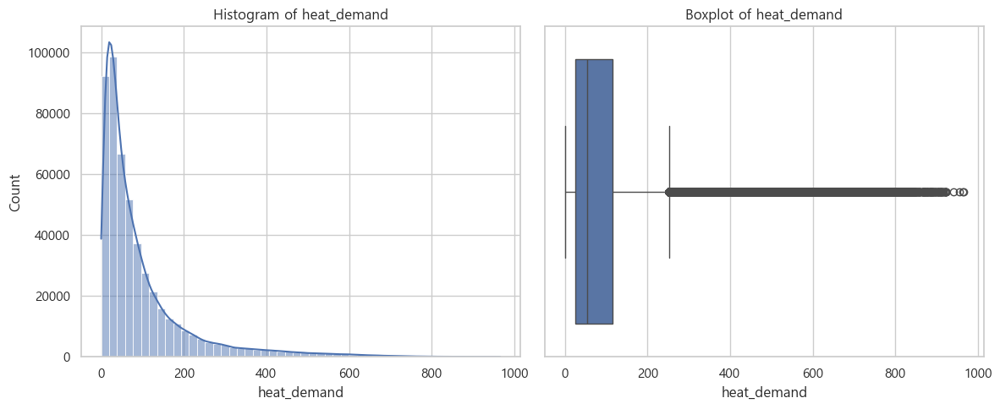

In [156]:
plt.figure(figsize=(12,5))

# 히스토그램
plt.subplot(1, 2, 1)
sns.histplot(heat['heat_demand'].dropna(), bins=50, kde=True)
plt.title('Histogram of heat_demand')

# 박스플롯
plt.subplot(1, 2, 2)
sns.boxplot(x=heat['heat_demand'])
plt.title('Boxplot of heat_demand')

plt.tight_layout()
plt.show()


In [157]:
from scipy.stats import skew

skewness = skew(heat['heat_demand'].dropna())
print(f"heat_demand의 왜도: {skewness:.4f}")


heat_demand의 왜도: 2.5391


In [158]:
heat['heat_demand'].describe()

count    499301.000000
mean         95.867813
std         115.262792
min           0.000000
25%          25.000000
50%          55.000000
75%         116.000000
max         966.000000
Name: heat_demand, dtype: float64

## 자기 상관

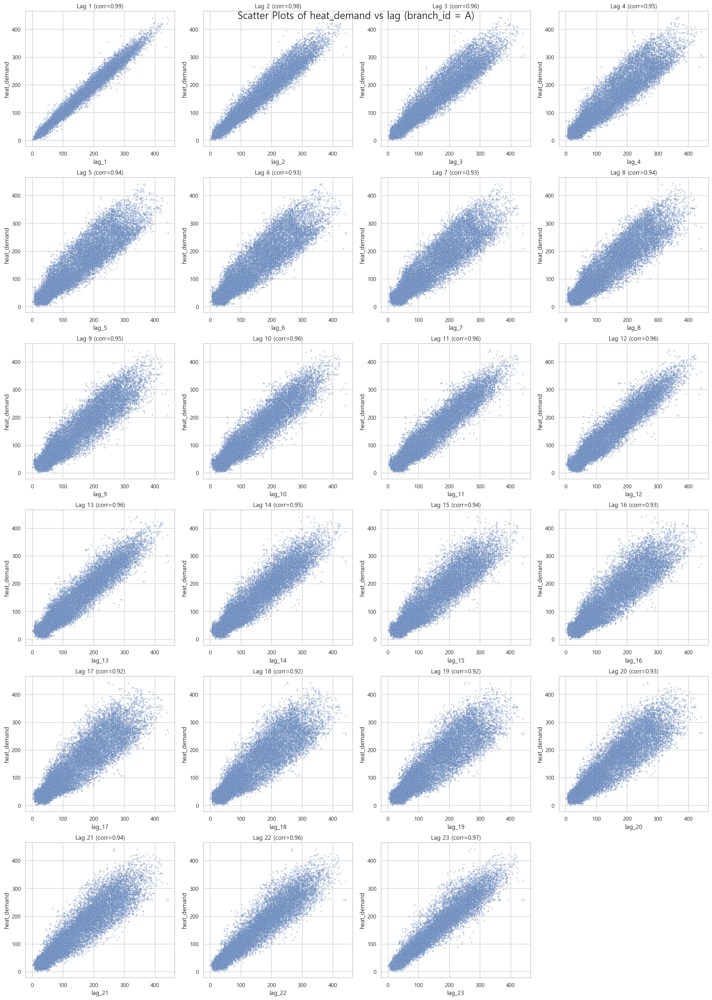

In [138]:

# branch_id == 'A' 필터링
heat_A = heat[heat['branch_id'] == 'A'].copy()

# 그래프 설정
plt.figure(figsize=(20, 30))
plt.suptitle('Scatter Plots of heat_demand vs lag (branch_id = A)', fontsize=20, y=0.92)

# 1~23 lag에 대해 반복
for lag in range(1, 24):
    heat_A[f'lag_{lag}'] = heat_A['heat_demand'].shift(lag)
    # 상관계수 계산 (dropna 필수)
    corr = heat_A[['heat_demand', f'lag_{lag}']].dropna().corr().iloc[0, 1]

    # subplot 위치 설정
    plt.subplot(6, 4, lag)  # 6행 4열 중 lag번째
    sns.scatterplot(
        data=heat_A, x=f'lag_{lag}', y='heat_demand',
        alpha=0.3, s=10
    )
    plt.title(f'Lag {lag} (corr={corr:.2f})')
    plt.xlabel(f'lag_{lag}')
    plt.ylabel('heat_demand')

plt.tight_layout()
plt.subplots_adjust(top=0.92)  # suptitle과 겹치지 않게
plt.show()


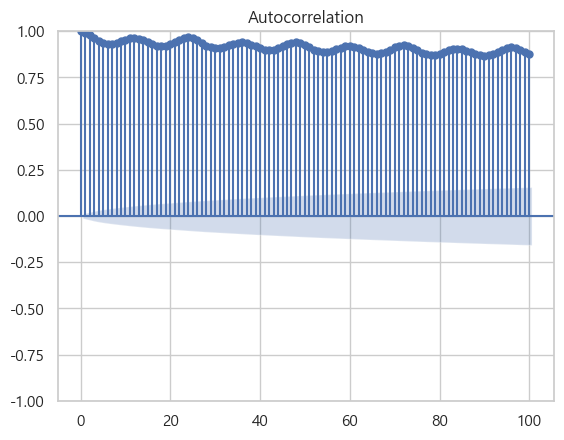

In [147]:
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

# 시계열 데이터로 index 설정 (필요 시)
# heat_A = heat_A.set_index('tm')

# ACF 플롯
plot_acf(heat_A['heat_demand'].dropna(), lags=100)
plt.show()


## STL

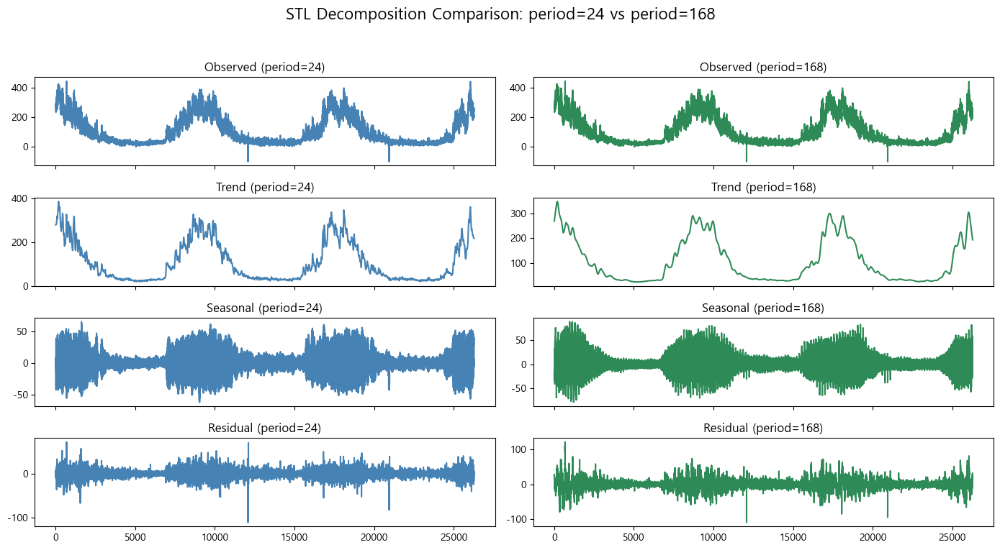

In [29]:
from statsmodels.tsa.seasonal import STL

# branch A 데이터만 필터링
branch_a = heat[heat['branch_id'] == 'A'].copy()

# 분해 대상 시계열: branch A의 heat_demand
series = branch_a['heat_demand']

# STL 분해 (period=24: 하루 주기)
stl_24 = STL(series, period=24).fit()

# STL 분해 (period=168: 주간 주기)
stl_168 = STL(series, period=168).fit()

# 시각화
fig, axes = plt.subplots(4, 2, figsize=(14, 8), sharex=True)
fig.suptitle('STL Decomposition Comparison: period=24 vs period=168', fontsize=16)

# titles
titles = ['Observed', 'Trend', 'Seasonal', 'Residual']

# 왼쪽: period=24
for i, attr in enumerate(['observed', 'trend', 'seasonal', 'resid']):
    axes[i, 0].plot(getattr(stl_24, attr), color='steelblue')
    axes[i, 0].set_title(f'{titles[i]} (period=24)')

# 오른쪽: period=168
for i, attr in enumerate(['observed', 'trend', 'seasonal', 'resid']):
    axes[i, 1].plot(getattr(stl_168, attr), color='seagreen')
    axes[i, 1].set_title(f'{titles[i]} (period=168)')

plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()



### 추세


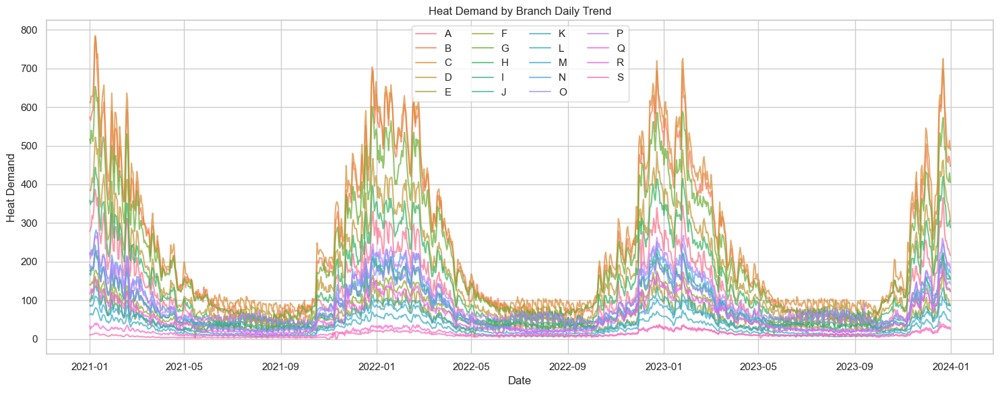

In [ ]:
# 브랜치별 일별 평균 추세

sns.set(style='whitegrid')
plt.figure(figsize=(15, 6))
sns.lineplot(data=daily, x='tm', y='heat_demand', hue='branch_id', alpha=0.7)
plt.title('Heat Demand by Branch Daily Trend')
plt.xlabel('Date')
plt.ylabel('Heat Demand')
plt.legend(ncol=4)
plt.tight_layout()
plt.show()


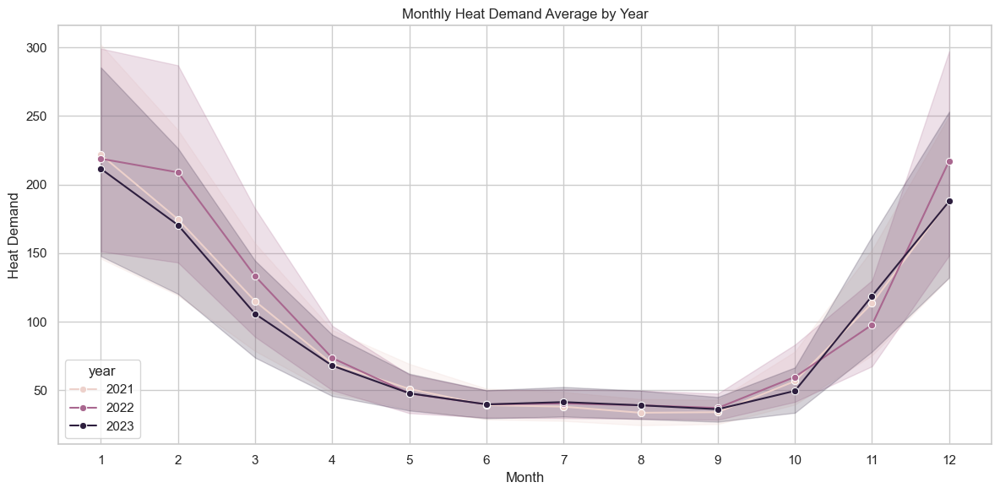

In [ ]:
# 연도-월별 평균 heat_demand 계산
monthly = heat.groupby(['year', 'month', 'branch_id'])['heat_demand'].mean().reset_index()

# 그래프 그리기
plt.figure(figsize=(12, 6))
sns.lineplot(data=monthly, x='month', y='heat_demand', hue='year', marker='o')

plt.title('Monthly Heat Demand Average by Year')
plt.xlabel('Month')
plt.ylabel('Heat Demand')
plt.xticks(range(1, 13))
plt.grid(True)
plt.tight_layout()
plt.show()


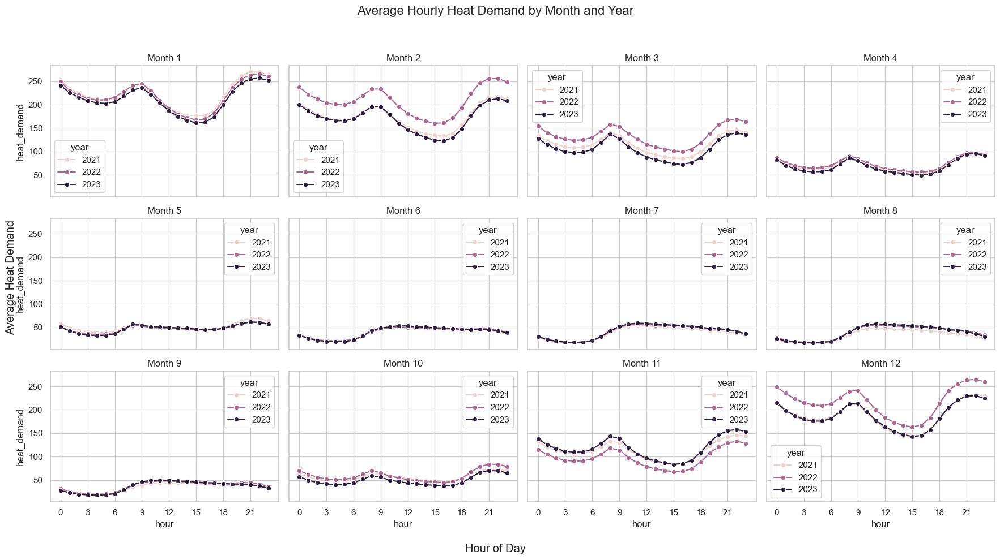

In [ ]:

# 월-시간-연도별 평균 열 수요 계산
hourly_month_year = (
    heat.groupby(['month', 'hour', 'year'])['heat_demand']
    .mean()
    .reset_index()
)

# 그래프 그리기
fig, axes = plt.subplots(3, 4, figsize=(18, 10), sharex=True, sharey=True)
axes = axes.flatten()

for month in range(1, 13):
    ax = axes[month - 1]
    data = hourly_month_year[hourly_month_year['month'] == month]
    sns.lineplot(data=data, x='hour', y='heat_demand', hue='year', marker='o', ax=ax)

    ax.set_title(f'Month {month}')
    ax.set_xticks(range(0, 24, 3))
    ax.grid(True)

# 공통 제목과 축 라벨
fig.suptitle('Average Hourly Heat Demand by Month and Year', fontsize=16)
fig.supxlabel('Hour of Day')
fig.supylabel('Average Heat Demand')
plt.tight_layout(rect=[0, 0, 1, 0.95])
plt.show()


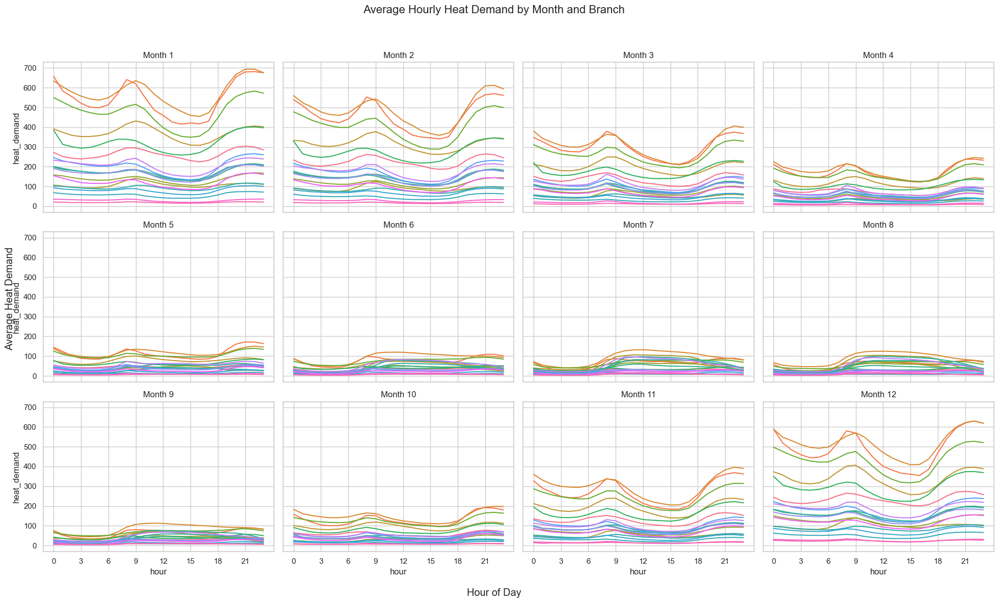

In [ ]:

# 월-시간-지점별 평균 열 수요 계산
hourly_month_branch = (
    heat.groupby(['month', 'hour', 'branch_id'])['heat_demand']
    .mean()
    .reset_index()
)

# 그래프 그리기
fig, axes = plt.subplots(3, 4, figsize=(20, 12), sharex=True, sharey=True)
axes = axes.flatten()

for month in range(1, 13):
    ax = axes[month - 1]
    data = hourly_month_branch[hourly_month_branch['month'] == month]
    sns.lineplot(data=data, x='hour', y='heat_demand', hue='branch_id', ax=ax, legend=False)

    ax.set_title(f'Month {month}')
    ax.set_xticks(range(0, 24, 3))
    ax.grid(True)

# 공통 제목과 축 라벨
fig.suptitle('Average Hourly Heat Demand by Month and Branch', fontsize=16)
fig.supxlabel('Hour of Day')
fig.supylabel('Average Heat Demand')
plt.tight_layout(rect=[0, 0, 1, 0.95])

plt.show()


# 피처 하나씩 보기

## branch_id

In [ ]:
heat['branch_id'].nunique()
# 19개의 지사

19

In [ ]:
heat['branch_id'].value_counts()
# 관측값의 개수는 모두 같음.

branch_id
A    26279
B    26279
C    26279
D    26279
E    26279
F    26279
G    26279
H    26279
I    26279
J    26279
K    26279
L    26279
M    26279
N    26279
O    26279
P    26279
Q    26279
R    26279
S    26279
Name: count, dtype: int64

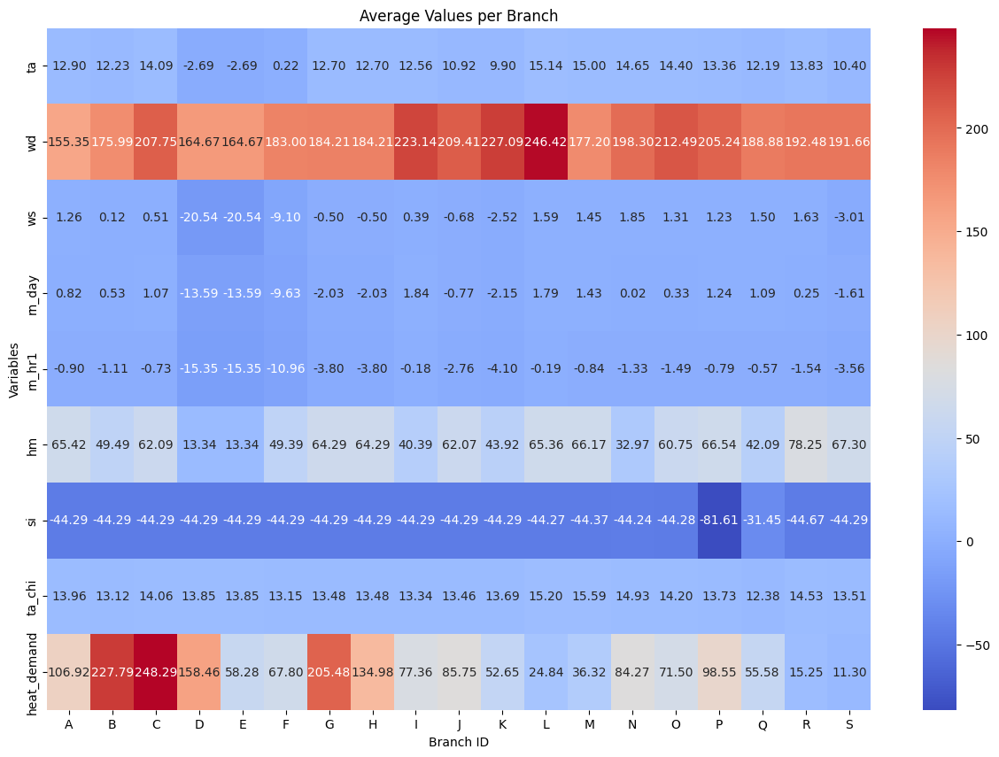

In [ ]:
# branch_id에 대한 나머지 수치형 데이터 평균값 확인

branch_mean = heat.groupby('branch_id').mean(numeric_only=True)
plt.figure(figsize=(15, 10))
sns.heatmap(branch_mean.T, annot=True, fmt=".2f", cmap='coolwarm')
plt.title("Average Values per Branch")
plt.xlabel("Branch ID")
plt.ylabel("Variables")
plt.show()


In [ ]:
from scipy.stats import f_oneway

groups = [group['heat_demand'] for name, group in heat.groupby('branch_id')]
f_stat, p_val = f_oneway(*groups)
print(f"ANOVA F-statistic: {f_stat}, p-value: {p_val}")


ANOVA F-statistic: 14671.508504394998, p-value: 0.0


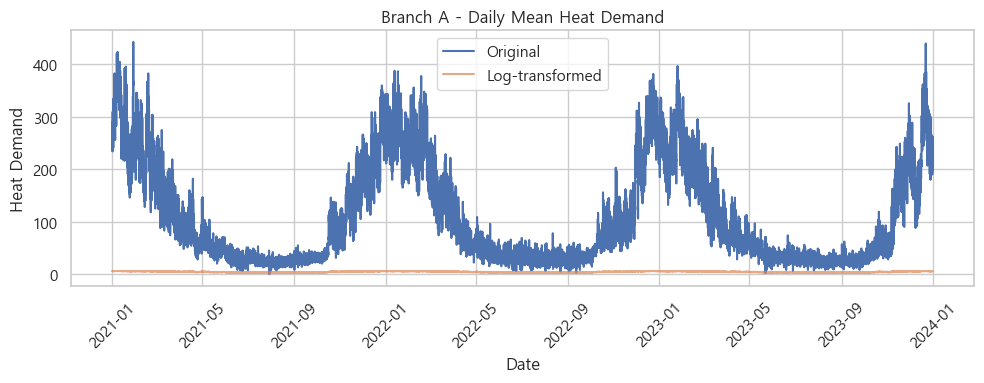

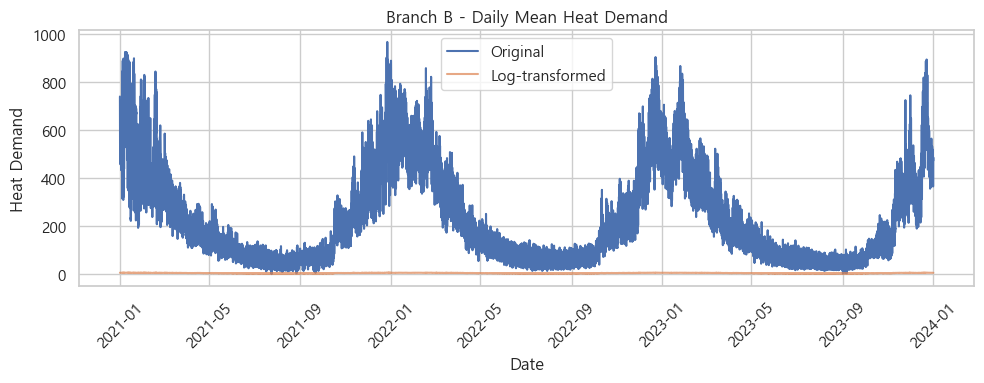

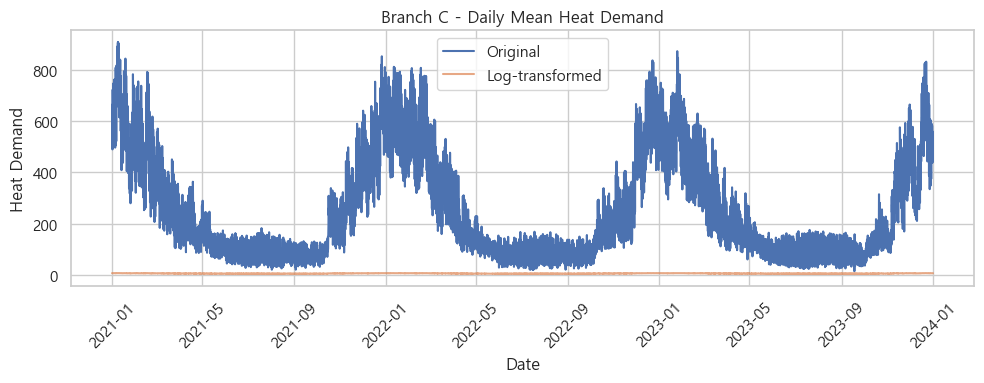

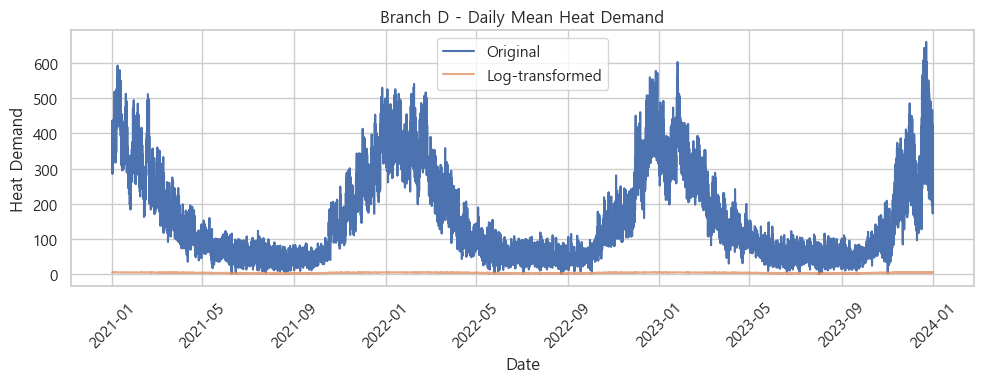

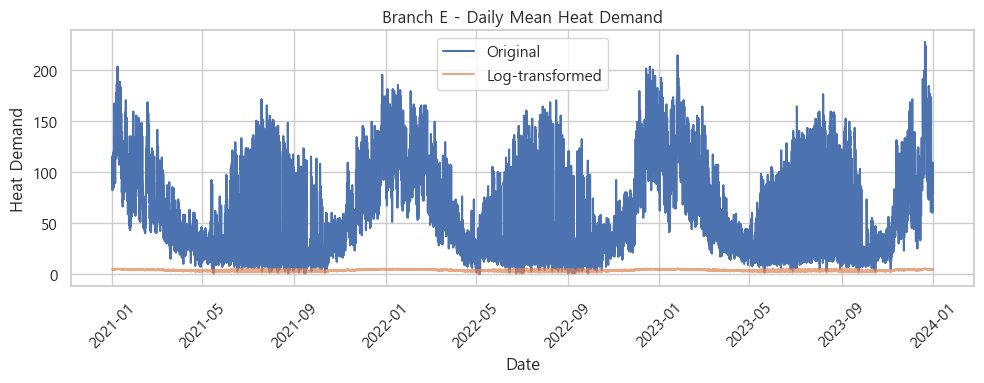

...

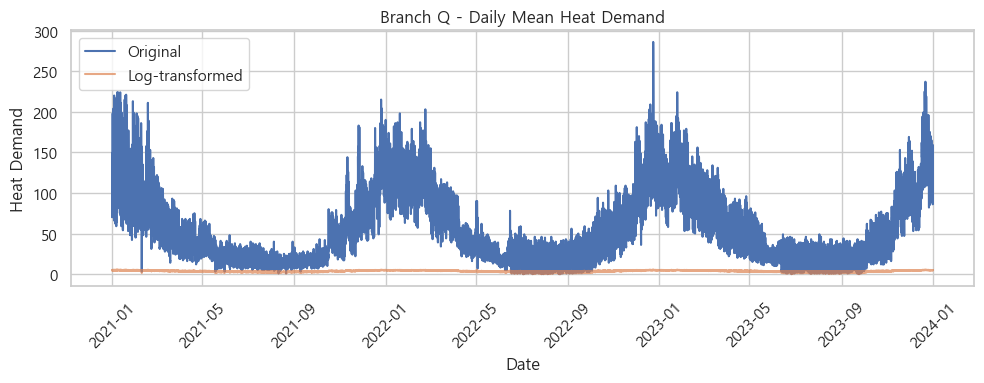

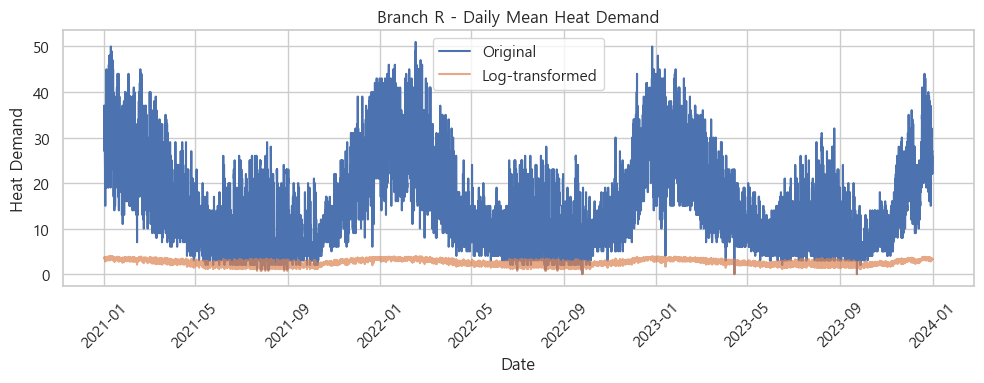

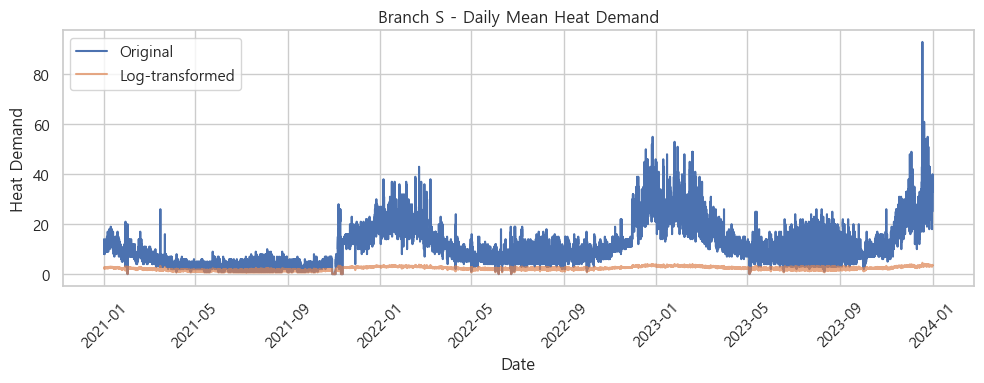

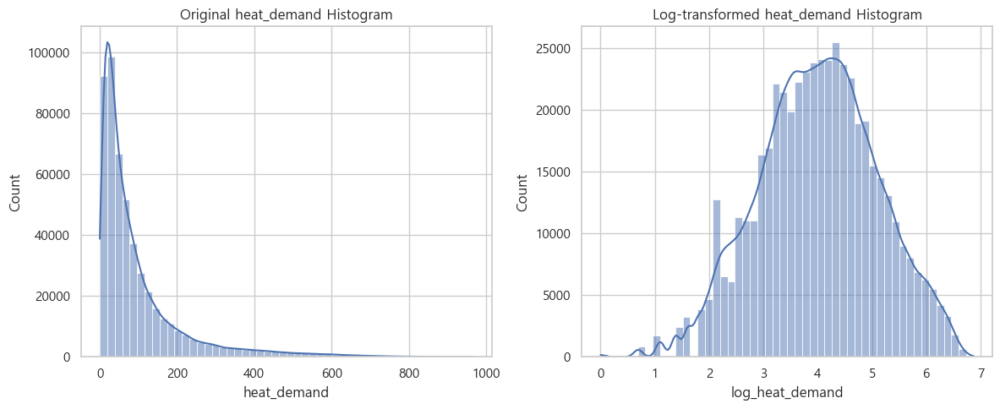

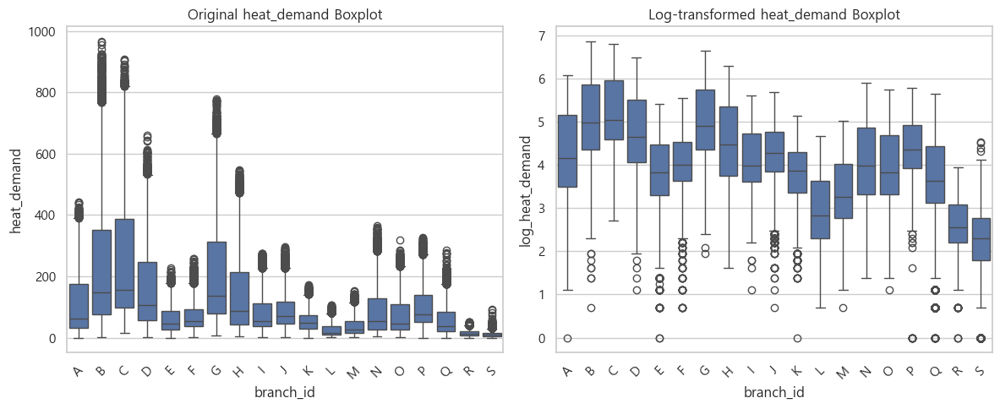

In [162]:

daily_avg = heat.groupby(['branch_id', 'tm'])['heat_demand'].mean().reset_index()

# 로그 변환 (0 이상 값만 가능하므로 작은 상수 더하기)
daily_avg['log_heat_demand'] = np.log1p(daily_avg['heat_demand'])

# 시각화
branches = daily_avg['branch_id'].unique()
n_branch = len(branches)

branches = daily_avg['branch_id'].unique()

# 지점별로 일별 평균 추세 플롯 (원본 vs 로그)
for b in branches:
    sub = daily_avg[daily_avg['branch_id'] == b]
    plt.figure(figsize=(10, 4))
    plt.plot(sub['tm'], sub['heat_demand'], label='Original')
    plt.plot(sub['tm'], sub['log_heat_demand'], label='Log-transformed', alpha=0.7)
    plt.title(f'Branch {b} - Daily Mean Heat Demand')
    plt.xlabel('Date')
    plt.ylabel('Heat Demand')
    plt.legend()
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()

# 히스토그램
plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 1)
sns.histplot(daily_avg['heat_demand'], bins=50, kde=True)
plt.title('Original heat_demand Histogram')

plt.subplot(1, 2, 2)
sns.histplot(daily_avg['log_heat_demand'], bins=50, kde=True)
plt.title('Log-transformed heat_demand Histogram')
plt.tight_layout()
plt.show()

# 박스플롯
plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 1)
sns.boxplot(data=daily_avg, x='branch_id', y='heat_demand')
plt.title('Original heat_demand Boxplot')
plt.xticks(rotation=45)

plt.subplot(1, 2, 2)
sns.boxplot(data=daily_avg, x='branch_id', y='log_heat_demand')
plt.title('Log-transformed heat_demand Boxplot')
plt.xticks(rotation=45)

plt.tight_layout()
plt.show()


## ta(기온), ta_chi(체감 온도)

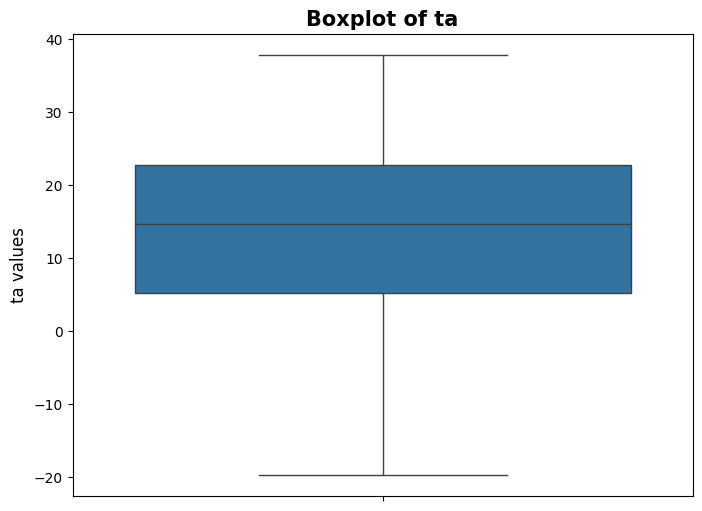

In [ ]:
plt.figure(figsize=(8, 6))
sns.boxplot(data=heat, y='ta')

plt.title('Boxplot of ta', fontsize=15, fontweight='bold')
plt.ylabel('ta values', fontsize=12)

plt.show()

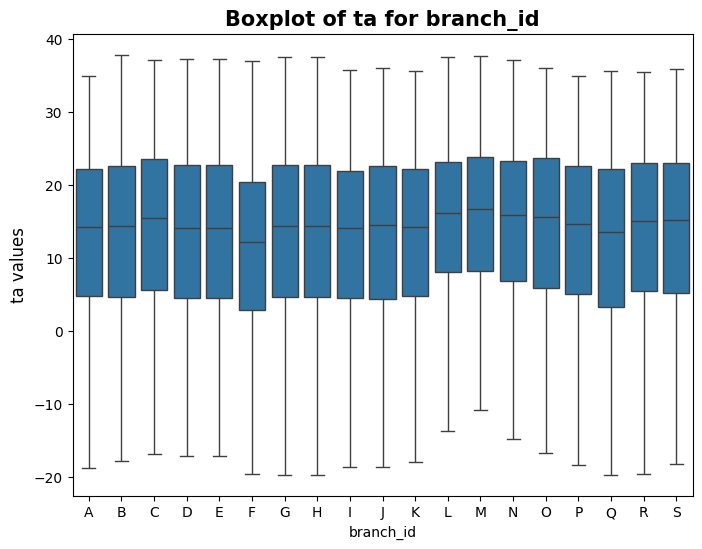

In [22]:
plt.figure(figsize=(8, 6))
sns.boxplot(data=heat, y='ta', x='branch_id')

plt.title('Boxplot of ta for branch_id', fontsize=15, fontweight='bold')
plt.ylabel('ta values', fontsize=12)

plt.show()

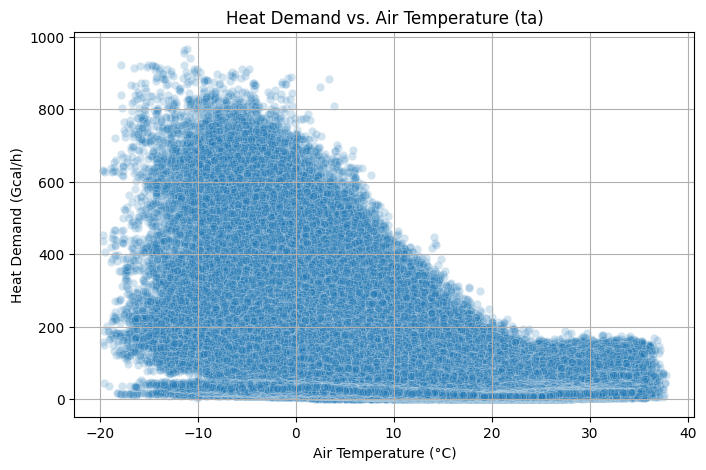

In [ ]:
# 산점도: heat_demand vs ta
plt.figure(figsize=(8, 5))
sns.scatterplot(x='ta', y='heat_demand', data=heat, alpha=0.2)
plt.title('Heat Demand vs. Air Temperature (ta)')
plt.xlabel('Air Temperature (°C)')
plt.ylabel('Heat Demand (Gcal/h)')
plt.grid(True)
plt.show()

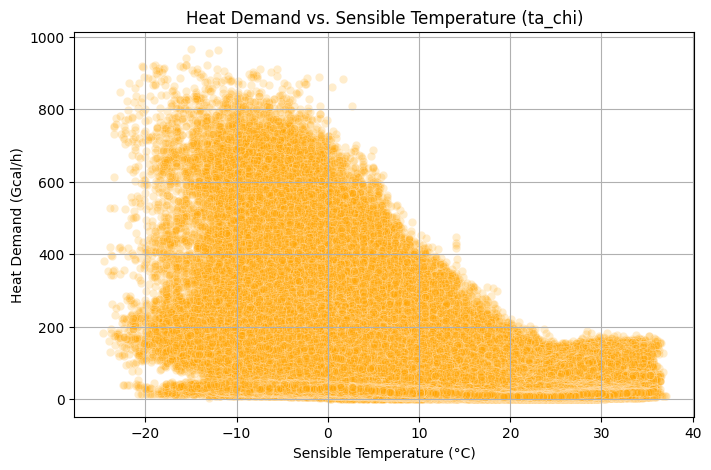

In [ ]:
# 산점도: heat_demand vs ta_chi
plt.figure(figsize=(8, 5))
sns.scatterplot(x='ta_chi', y='heat_demand', data=heat, alpha=0.2, color='orange')
plt.title('Heat Demand vs. Sensible Temperature (ta_chi)')
plt.xlabel('Sensible Temperature (°C)')
plt.ylabel('Heat Demand (Gcal/h)')
plt.grid(True)
plt.show()

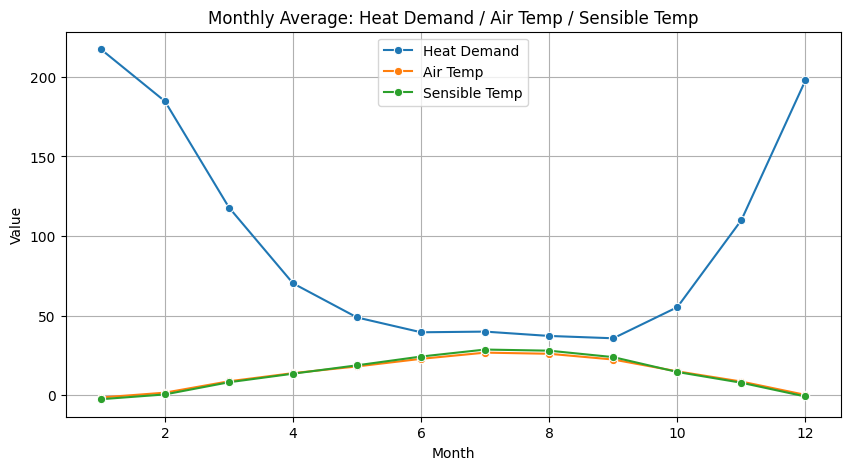

In [25]:
# 월별 평균 heat_demand, ta, ta_chi
monthly = heat.groupby('month')[['heat_demand', 'ta', 'ta_chi']].mean().reset_index()
plt.figure(figsize=(10, 5))
sns.lineplot(x='month', y='heat_demand', data=monthly, marker='o', label='Heat Demand')
sns.lineplot(x='month', y='ta', data=monthly, marker='o', label='Air Temp')
sns.lineplot(x='month', y='ta_chi', data=monthly, marker='o', label='Sensible Temp')
plt.title('Monthly Average: Heat Demand / Air Temp / Sensible Temp')
plt.xlabel('Month')
plt.ylabel('Value')
plt.legend()
plt.grid(True)
plt.show()

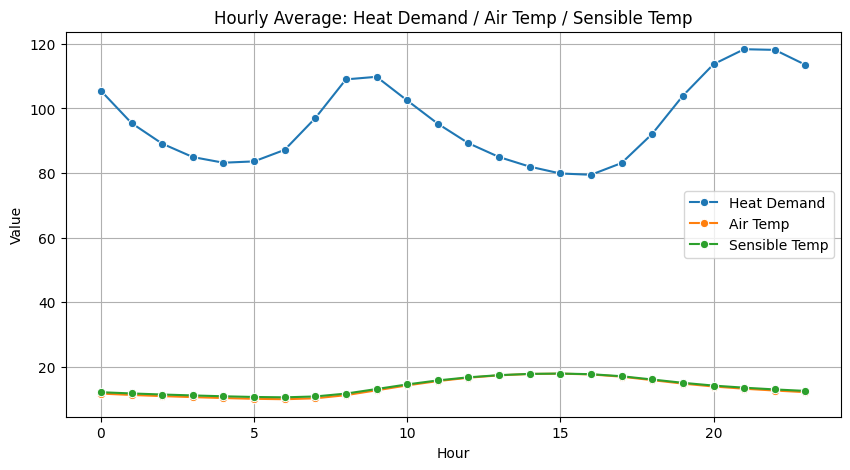

In [26]:
# 시간대별 평균 heat_demand, ta, ta_chi
hourly = heat.groupby('hour')[['heat_demand', 'ta', 'ta_chi']].mean().reset_index()
plt.figure(figsize=(10, 5))
sns.lineplot(x='hour', y='heat_demand', data=hourly, marker='o', label='Heat Demand')
sns.lineplot(x='hour', y='ta', data=hourly, marker='o', label='Air Temp')
sns.lineplot(x='hour', y='ta_chi', data=hourly, marker='o', label='Sensible Temp')
plt.title('Hourly Average: Heat Demand / Air Temp / Sensible Temp')
plt.xlabel('Hour')
plt.ylabel('Value')
plt.legend()
plt.grid(True)
plt.show()

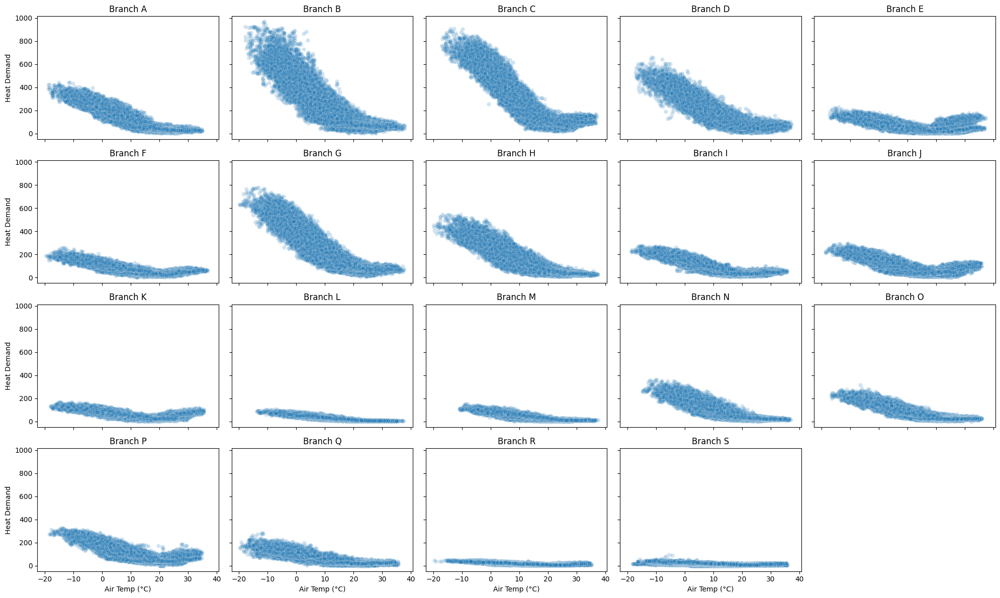

In [28]:
# 브랜치별 산점도
branches = sorted(heat['branch_id'].unique())

n_branches = len(branches)
ncols = 5
nrows = int(np.ceil(n_branches / ncols))

fig, axes = plt.subplots(nrows, ncols, figsize=(ncols*4, nrows*3), sharex=True, sharey=True)
axes = axes.flatten()

for i, b in enumerate(branches):
    ax = axes[i]
    sns.scatterplot(
        x='ta', y='heat_demand',
        data=heat[heat['branch_id'] == b],
        alpha=0.2,
        ax=ax
    )
    ax.set_title(f'Branch {b}')
    ax.set_xlabel('Air Temp (°C)')
    ax.set_ylabel('Heat Demand')

for j in range(i+1, len(axes)):
    axes[j].set_visible(False)

plt.tight_layout()
plt.show()


## hm상대습도 ws풍속 wd풍향

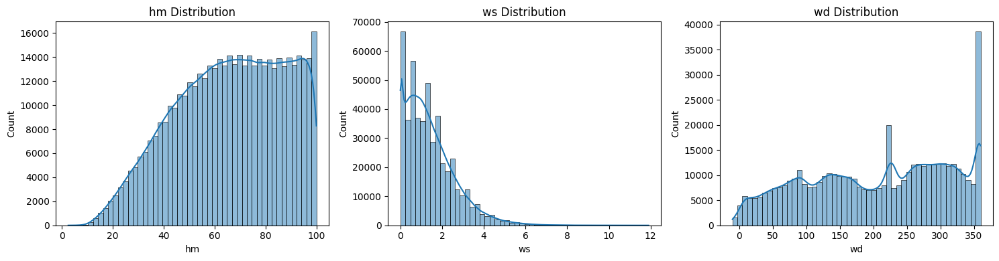

In [34]:
plt.figure(figsize=(15, 4))
for i, col in enumerate(['hm', 'ws', 'wd']):
    plt.subplot(1, 3, i+1)
    sns.histplot(heat[col], bins=50, kde=True)
    plt.title(f'{col} Distribution')
plt.tight_layout()
plt.show()


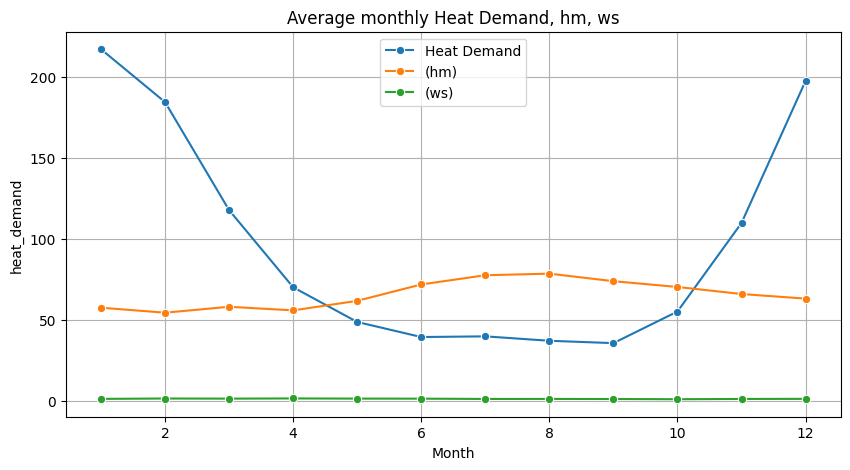

In [47]:
monthly = heat.groupby('month')[['heat_demand', 'hm', 'ws']].mean().reset_index()
plt.figure(figsize=(10, 5))
sns.lineplot(x='month', y='heat_demand', data=monthly, marker='o', label='Heat Demand')
sns.lineplot(x='month', y='hm', data=monthly, marker='o', label='(hm)')
sns.lineplot(x='month', y='ws', data=monthly, marker='o', label='(ws)')
plt.title('Average monthly Heat Demand, hm, ws')
plt.xlabel('Month')
plt.legend()
plt.grid(True)
plt.show()


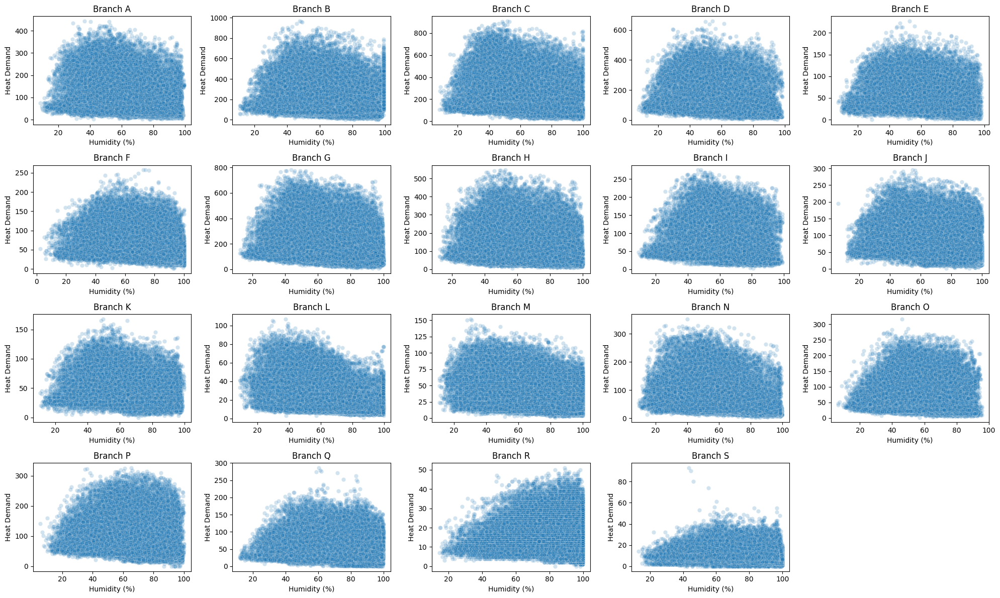

In [36]:
# heat_demand vs 습도(hm)
ncols = 5
nrows = int(np.ceil(len(branches) / ncols))
plt.figure(figsize=(ncols*4, nrows*3))
for i, b in enumerate(branches):
    plt.subplot(nrows, ncols, i+1)
    sns.scatterplot(
        x='hm', y='heat_demand',
        data=heat[heat['branch_id'] == b],
        alpha=0.2
    )
    plt.title(f'Branch {b}')
    plt.xlabel('Humidity (%)')
    plt.ylabel('Heat Demand')
plt.tight_layout()
plt.show()

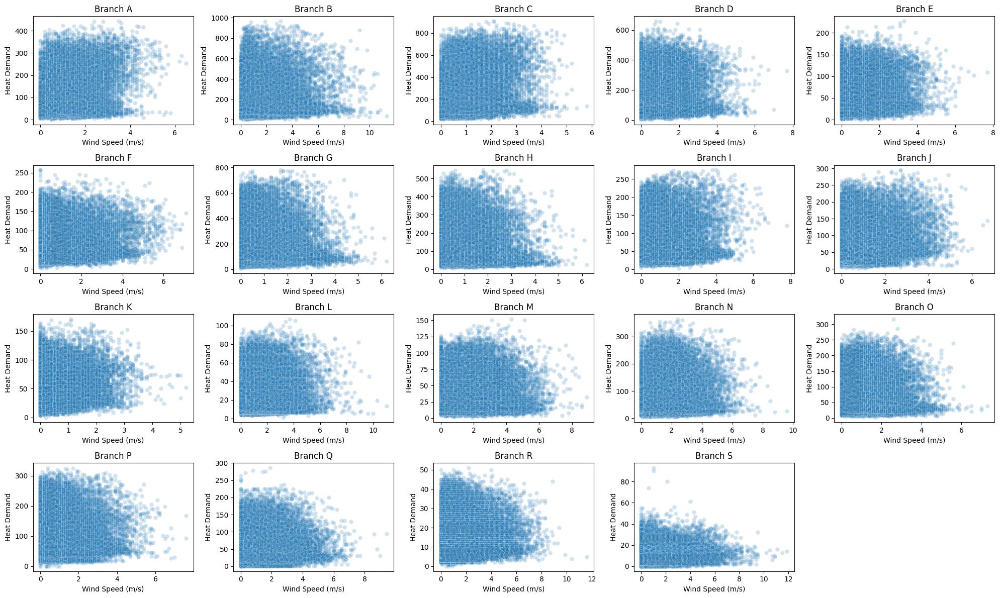

In [38]:
# heat_demand vs 풍속(WS)
plt.figure(figsize=(ncols*4, nrows*3))
for i, b in enumerate(branches):
    plt.subplot(nrows, ncols, i+1)
    sns.scatterplot(
        x='ws', y='heat_demand',
        data=heat[heat['branch_id'] == b],
        alpha=0.2
    )
    plt.title(f'Branch {b}')
    plt.xlabel('Wind Speed (m/s)')
    plt.ylabel('Heat Demand')
plt.tight_layout()
plt.show()

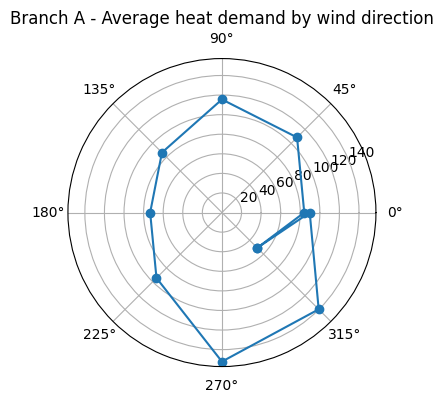

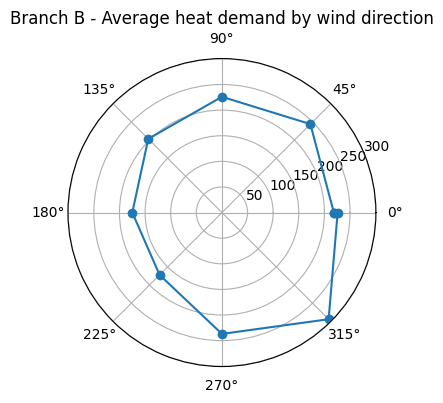

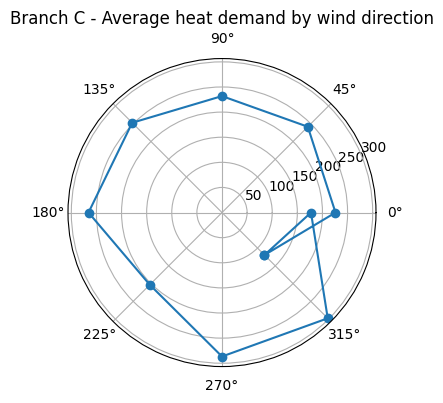

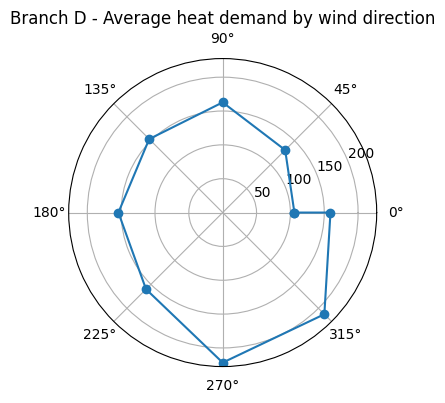

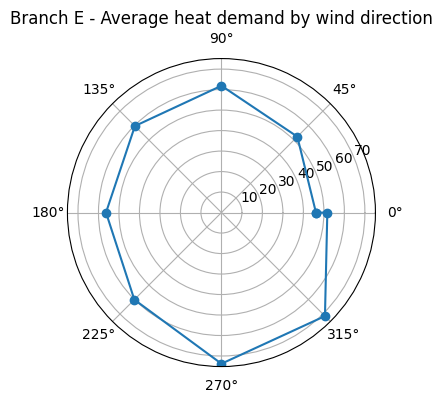

...

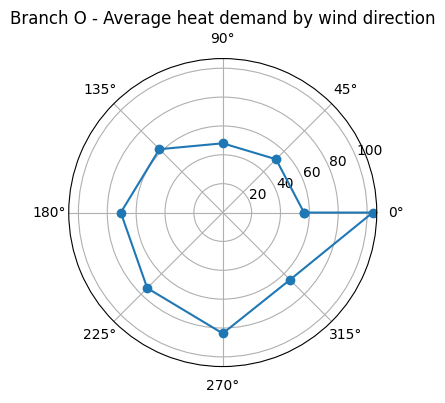

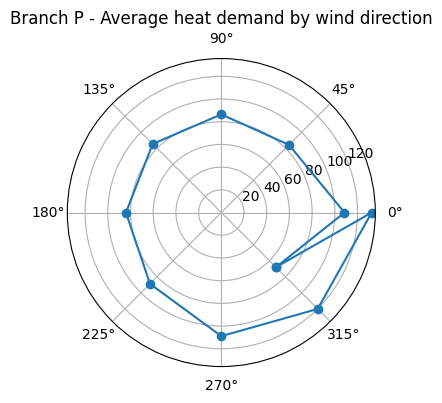

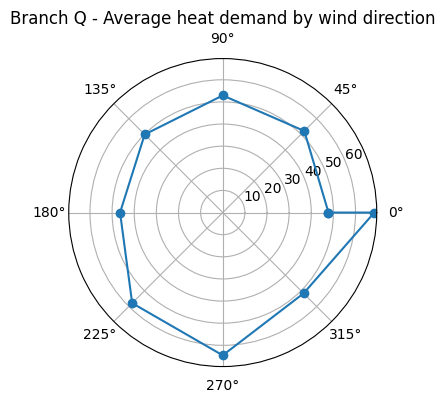

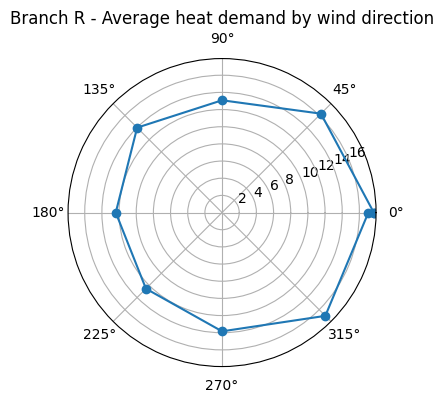

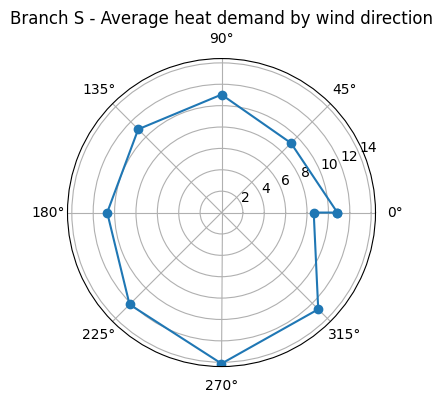

In [40]:
#  브랜치별 풍향(wd)별 열수요 평균
for b in branches:
    df = heat[heat['branch_id'] == b].copy()
    df['wd_sector'] = (df['wd'] // 45 * 45).fillna(0)
    wd_mean = df.groupby('wd_sector')['heat_demand'].mean()
    angles = np.deg2rad(wd_mean.index)
    values = wd_mean.values
    angles = np.concatenate([angles, [angles[0]]])
    values = np.concatenate([values, [values[0]]])
    plt.figure(figsize=(4, 4))
    plt.polar(angles, values, marker='o')
    plt.title(f'Branch {b} - Average heat demand by wind direction')
    plt.show()

In [42]:
corrs = []
for b in branches:
    df = heat[heat['branch_id'] == b]
    c_hm = df[['heat_demand', 'hm']].corr().iloc[0,1]
    c_ws = df[['heat_demand', 'ws']].corr().iloc[0,1]
    corrs.append({'branch_id': b, 'corr_hm': c_hm, 'ws': c_ws})
corr_df = pd.DataFrame(corrs)
print(corr_df)

   branch_id   corr_hm        ws
0          A -0.341785  0.222922
1          B -0.200272  0.003871
2          C -0.253400  0.116825
3          D -0.237062  0.048245
4          E -0.183071  0.149701
5          F -0.197848  0.047087
6          G -0.232459 -0.123687
7          H -0.246056 -0.115500
8          I -0.187240 -0.003871
9          J -0.225428  0.066718
10         K -0.233226  0.107785
11         L -0.472329  0.095026
12         M -0.349087 -0.070064
13         N -0.338390 -0.058589
14         O -0.158866 -0.117280
15         P -0.173584 -0.051590
16         Q -0.173229 -0.091167
17         R -0.023603  0.017204
18         S -0.137540  0.031274


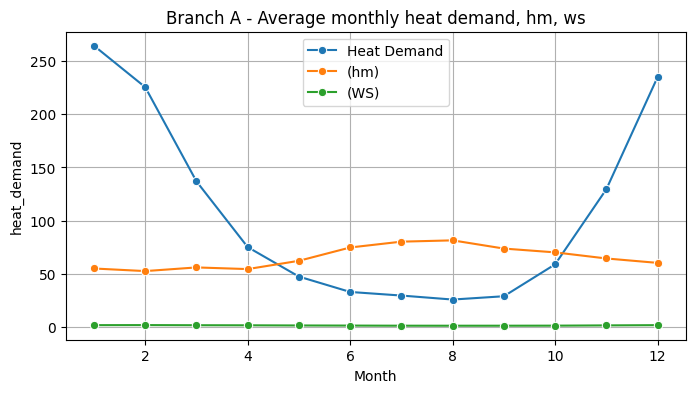

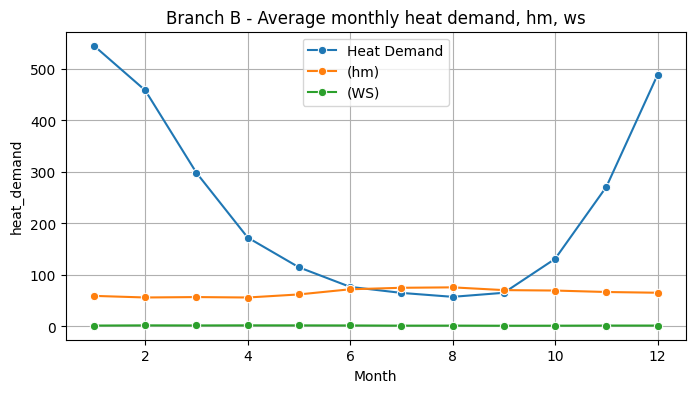

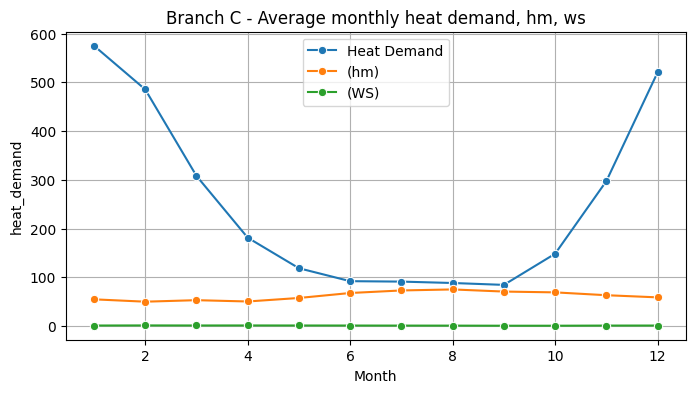

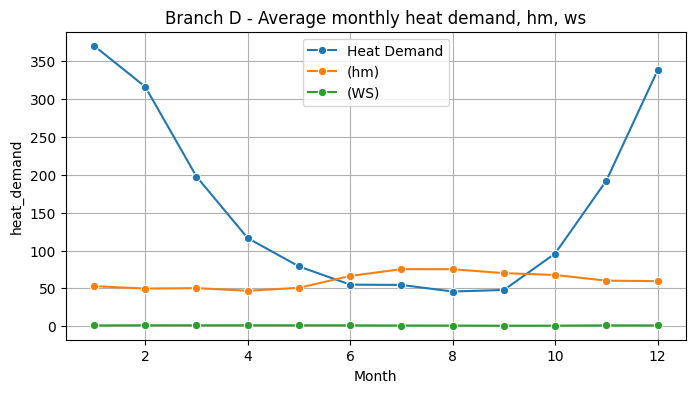

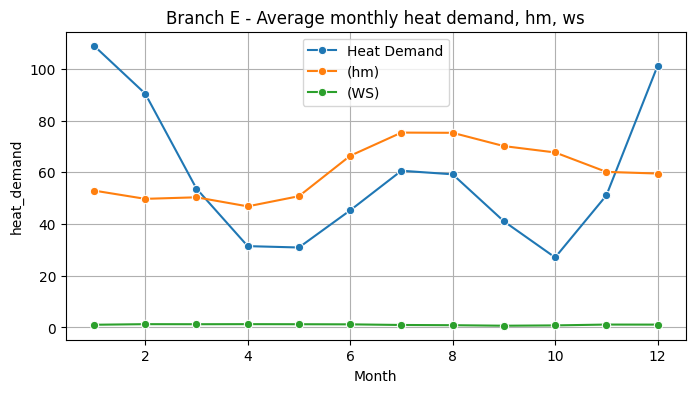

...

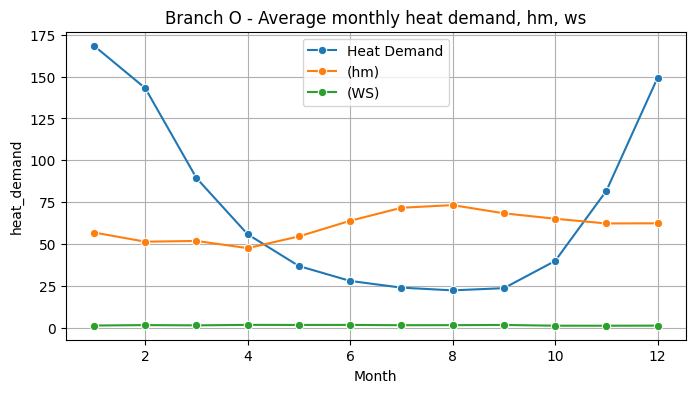

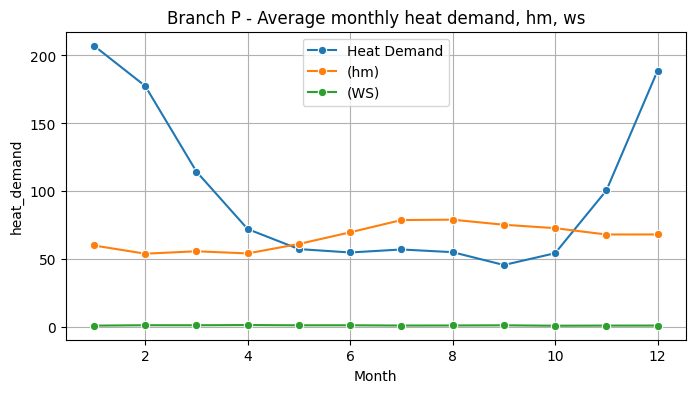

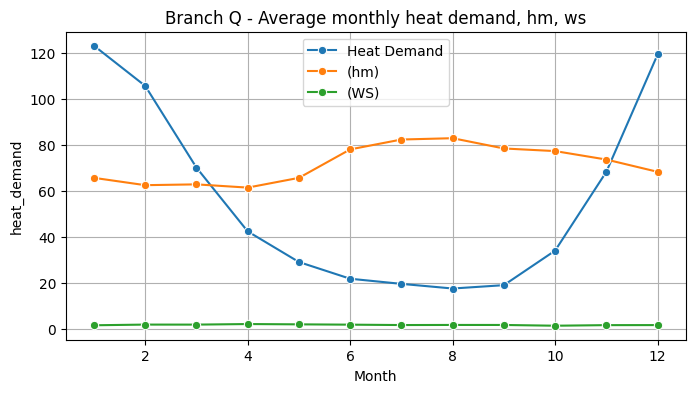

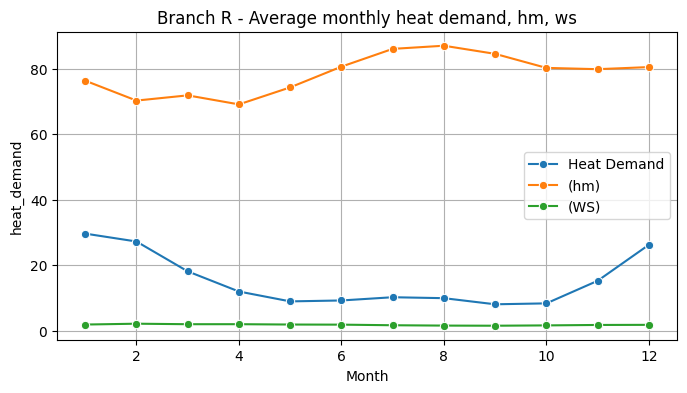

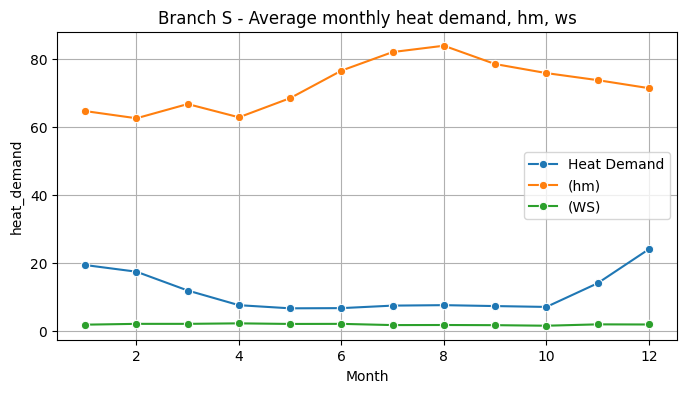

In [46]:
for b in branches:
    df = heat[heat['branch_id'] == b]
    monthly = df.groupby('month')[['heat_demand', 'hm', 'ws']].mean().reset_index()
    plt.figure(figsize=(8, 4))
    sns.lineplot(x='month', y='heat_demand', data=monthly, marker='o', label='Heat Demand')
    sns.lineplot(x='month', y='hm', data=monthly, marker='o', label='(hm)')
    sns.lineplot(x='month', y='ws', data=monthly, marker='o', label='(WS)')
    plt.title(f'Branch {b} - Average monthly heat demand, hm, ws')
    plt.xlabel('Month')
    plt.legend()
    plt.grid(True)
    plt.show()


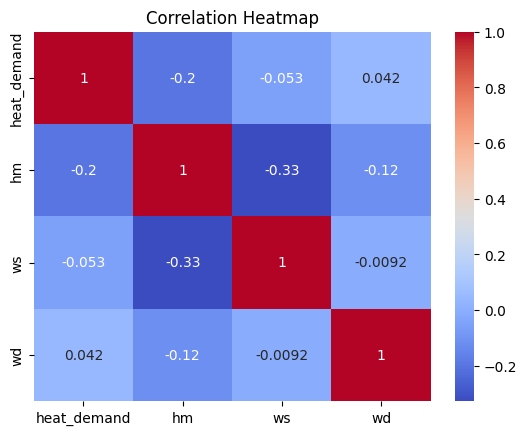

In [48]:
# 변수별 상관관계 히트맵
corr = heat[['heat_demand', 'hm', 'ws', 'wd']].corr()
sns.heatmap(corr, annot=True, cmap='coolwarm')
plt.title('Correlation Heatmap')
plt.show()


## rn_day(일 강수량), rn_hr1(시간 강수량)

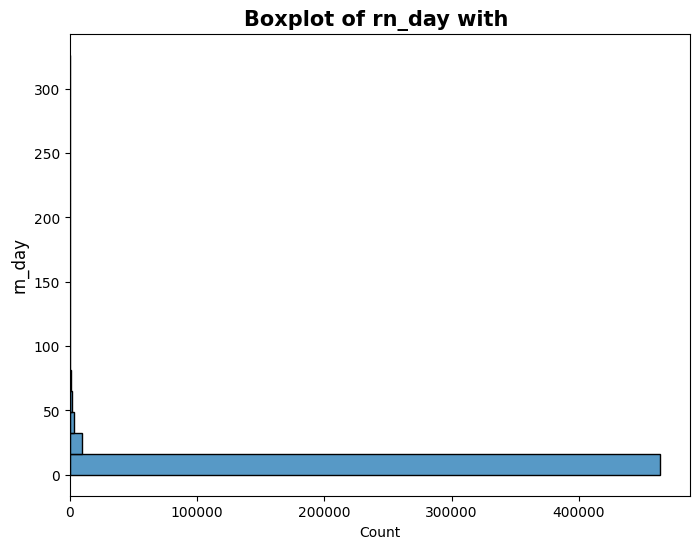

In [54]:
plt.figure(figsize=(8, 6))
sns.histplot(data=heat, y='rn_day')

plt.title('Boxplot of rn_day with ', fontsize=15, fontweight='bold')
plt.ylabel('rn_day', fontsize=12)

plt.show()


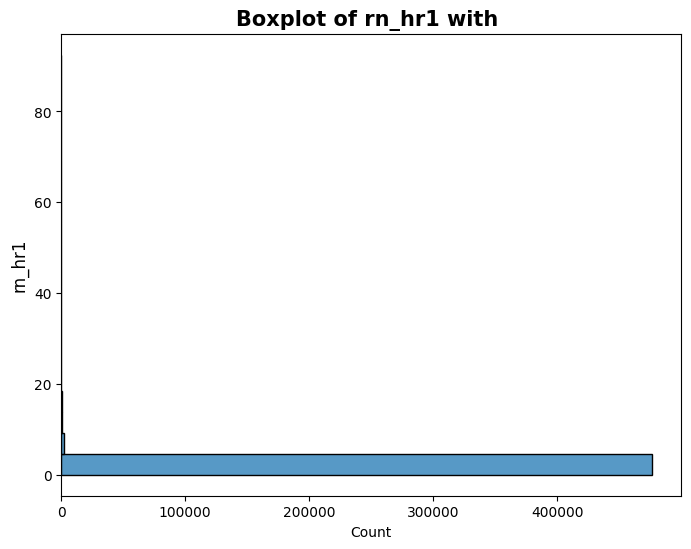

In [55]:
plt.figure(figsize=(8, 6))
sns.histplot(data=heat, y='rn_hr1')

plt.title('Boxplot of rn_hr1 with ', fontsize=15, fontweight='bold')
plt.ylabel('rn_hr1', fontsize=12)

plt.show()


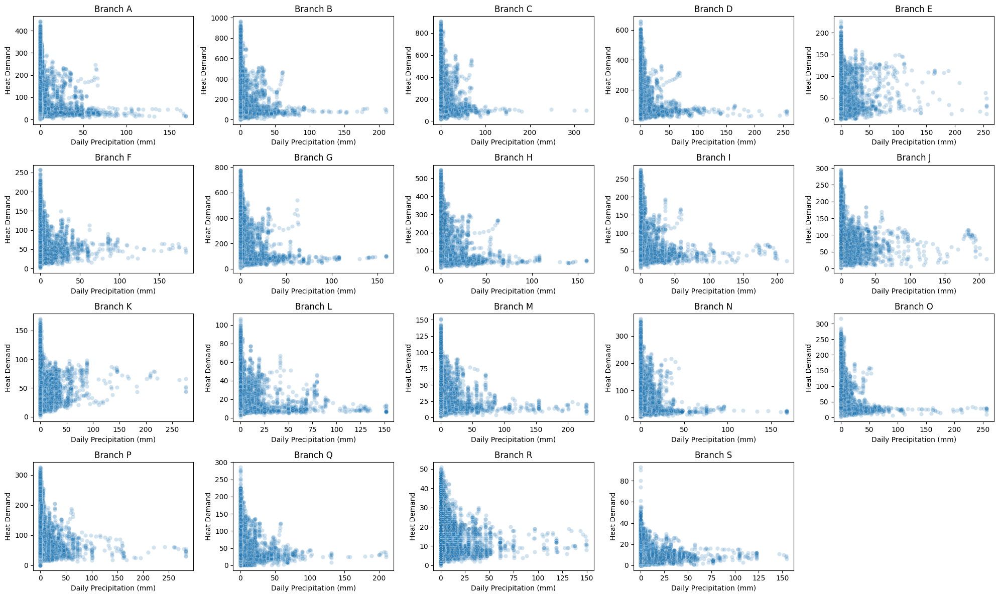

In [49]:
# heat_demand vs rn_day
plt.figure(figsize=(ncols*4, nrows*3))
for i, b in enumerate(branches):
    plt.subplot(nrows, ncols, i+1)
    sns.scatterplot(
        x='rn_day', y='heat_demand',
        data=heat[heat['branch_id'] == b],
        alpha=0.2
    )
    plt.title(f'Branch {b}')
    plt.xlabel('Daily Precipitation (mm)')
    plt.ylabel('Heat Demand')
plt.tight_layout()
plt.show()

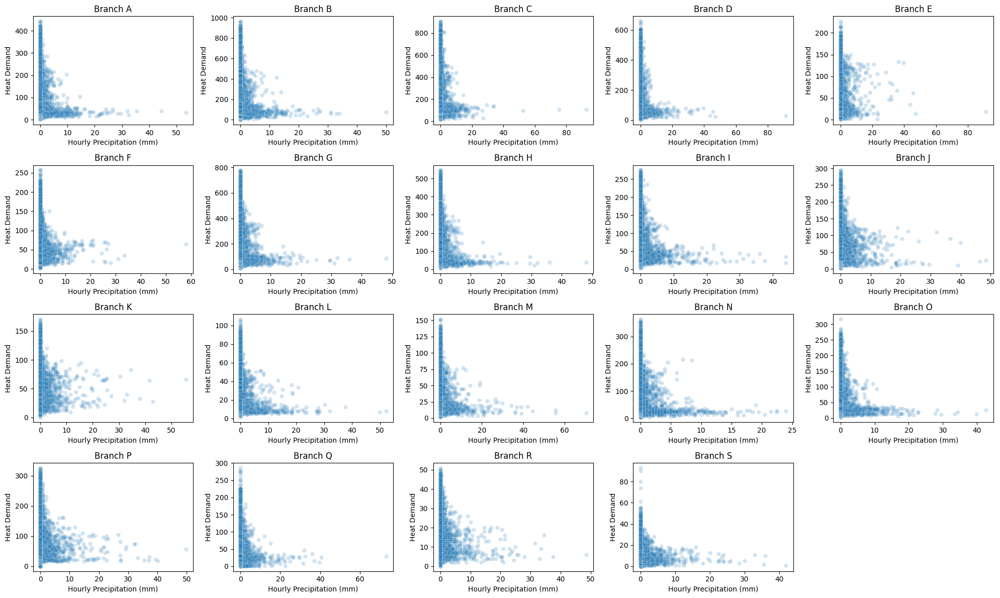

In [50]:
# heat_demand vs rn_hr1
plt.figure(figsize=(ncols*4, nrows*3))
for i, b in enumerate(branches):
    plt.subplot(nrows, ncols, i+1)
    sns.scatterplot(
        x='rn_hr1', y='heat_demand',
        data=heat[heat['branch_id'] == b],
        alpha=0.2
    )
    plt.title(f'Branch {b}')
    plt.xlabel('Hourly Precipitation (mm)')
    plt.ylabel('Heat Demand')
plt.tight_layout()
plt.show()

https://www.hrfco.go.kr/web/floodPage/weatherTerms.do


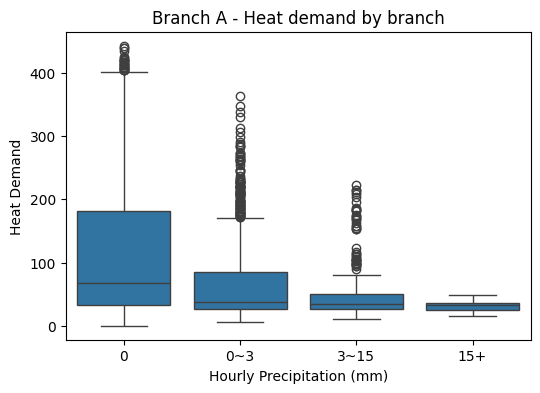

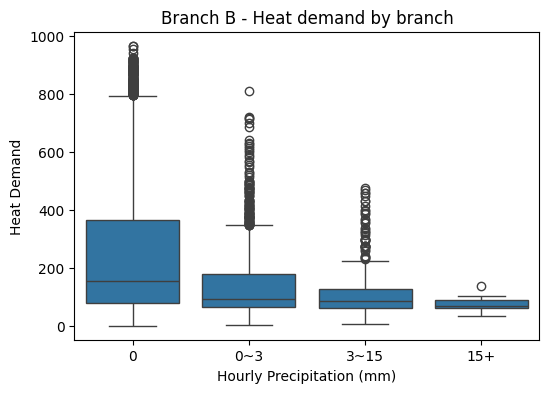

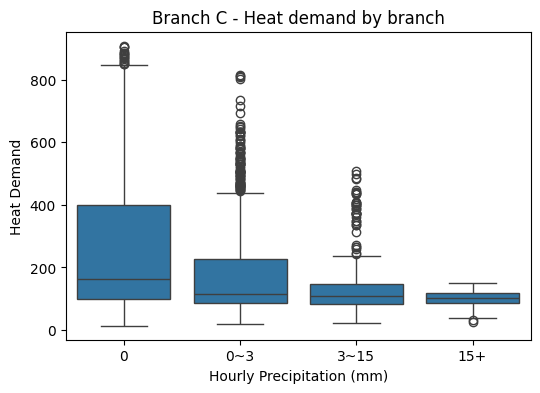

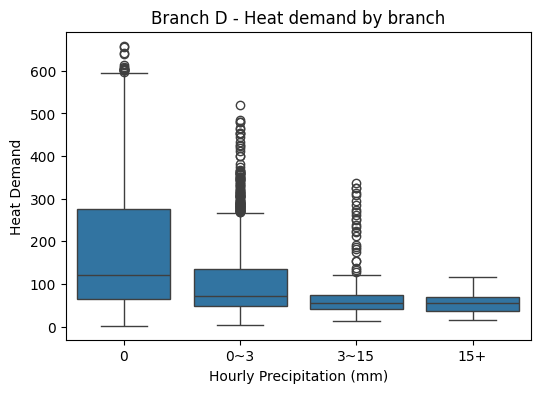

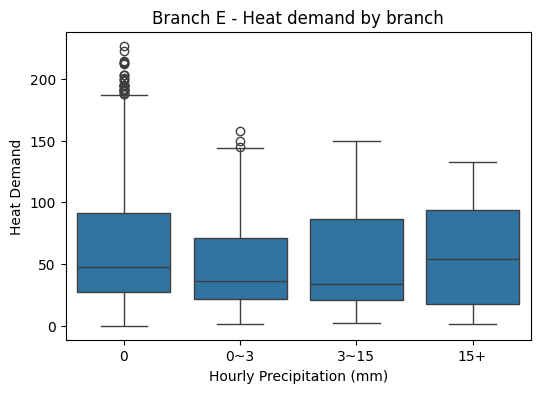

...

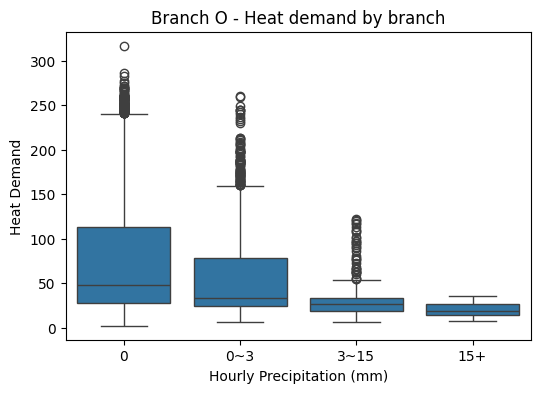

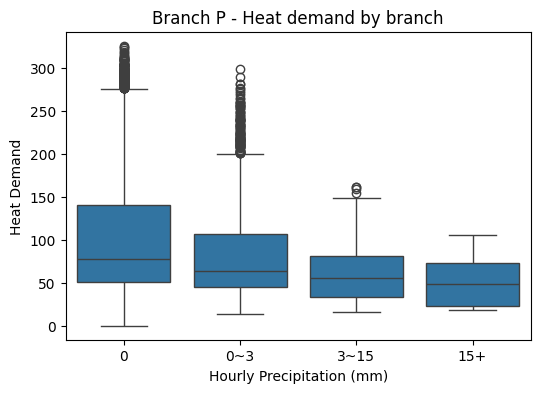

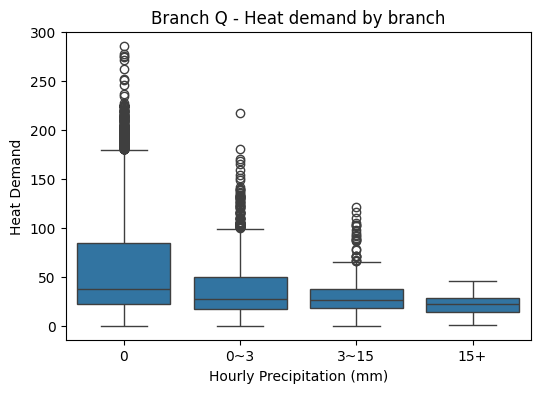

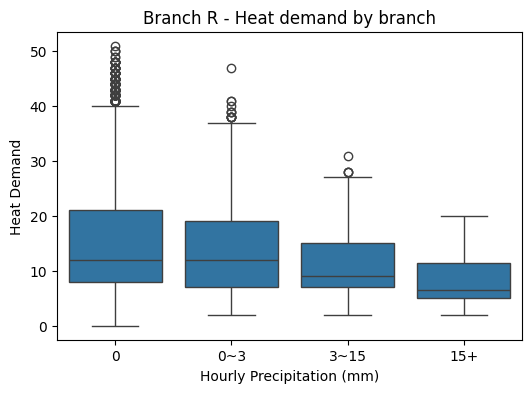

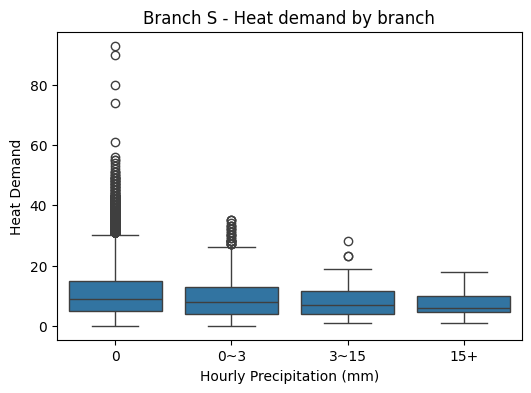

In [58]:
# 강수량 구간화
heat['rn_hr1_bin'] = pd.cut(heat['rn_hr1'], bins=[-0.1, 0, 3, 15, np.inf], labels=['0', '0~3', '3~15', '15+'])

for b in branches:
    plt.figure(figsize=(6, 4))
    sns.boxplot(x='rn_hr1_bin', y='heat_demand', data=heat[heat['branch_id'] == b])
    plt.title(f'Branch {b} - Heat demand by branch')
    plt.xlabel('Hourly Precipitation (mm)')
    plt.ylabel('Heat Demand')
    plt.show()

## si 일사량

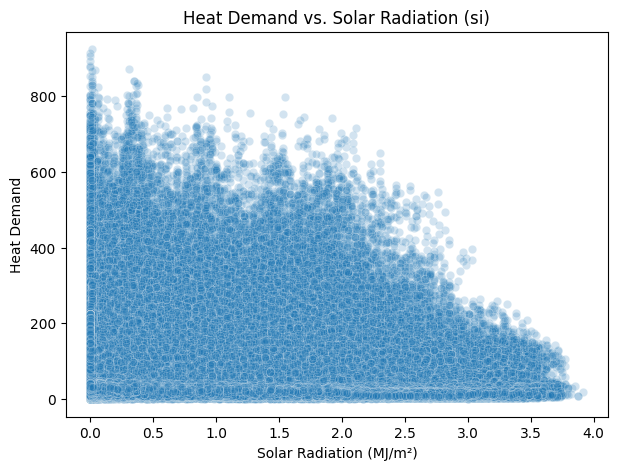

In [59]:
# heat_demand vs si 산점도 (전체)
plt.figure(figsize=(7, 5))
sns.scatterplot(x='si', y='heat_demand', data=heat, alpha=0.2)
plt.title('Heat Demand vs. Solar Radiation (si)')
plt.xlabel('Solar Radiation (MJ/m²)')
plt.ylabel('Heat Demand')
plt.show()


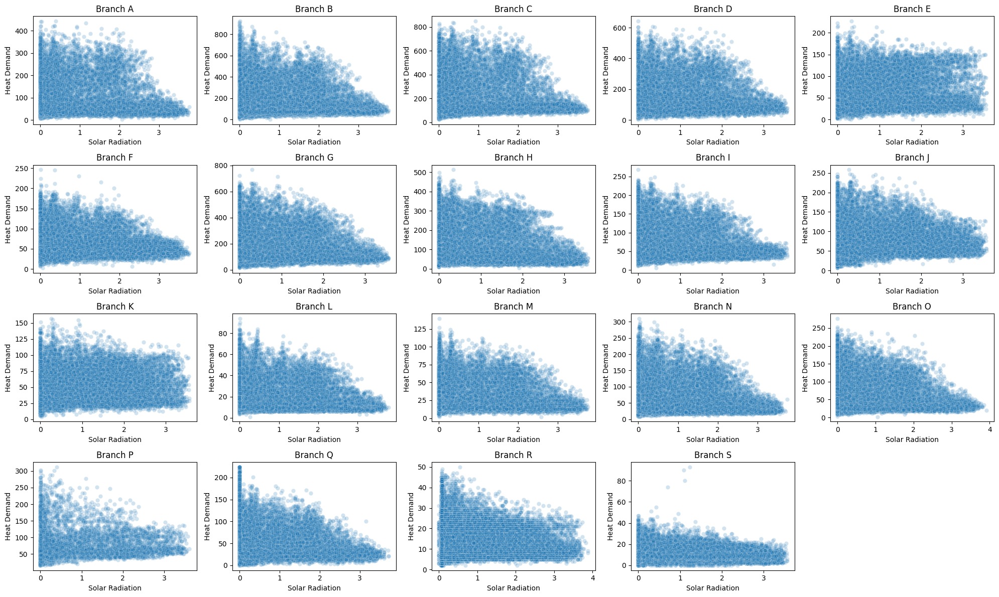

In [60]:
# 2) 브랜치별 heat_demand vs si 산점도
branches = sorted(heat['branch_id'].unique())
ncols = 5
nrows = int(np.ceil(len(branches) / ncols))
plt.figure(figsize=(ncols*4, nrows*3))
for i, b in enumerate(branches):
    plt.subplot(nrows, ncols, i+1)
    sns.scatterplot(
        x='si', y='heat_demand',
        data=heat[heat['branch_id'] == b],
        alpha=0.2
    )
    plt.title(f'Branch {b}')
    plt.xlabel('Solar Radiation')
    plt.ylabel('Heat Demand')
plt.tight_layout()
plt.show()


In [61]:
# 3) 결측치 제거 후 상관계수
corr = heat[['heat_demand', 'si']].dropna().corr().iloc[0,1]
print(f"heat_demand와 si의 상관계수: {corr:.3f}")

heat_demand와 si의 상관계수: -0.092


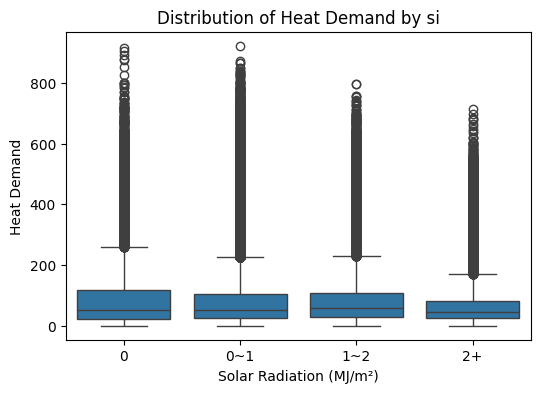

In [63]:
# si 구간화 (예: 0, 0~1, 1~2, 2+)
heat['si_bin'] = pd.cut(heat['si'], bins=[-0.1, 0, 1, 2, np.inf], labels=['0', '0~1', '1~2', '2+'])
plt.figure(figsize=(6,4))
sns.boxplot(x='si_bin', y='heat_demand', data=heat)
plt.title('Distribution of Heat Demand by si')
plt.xlabel('Solar Radiation (MJ/m²)')
plt.ylabel('Heat Demand')
plt.show()


## 시간 변수들

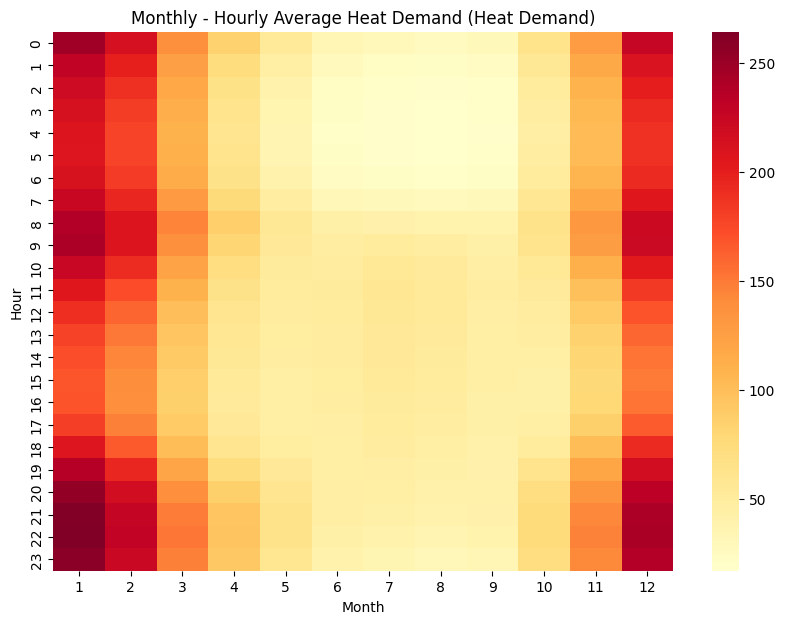

In [65]:
# 월-시간별 평균 열수요
pivot = heat.pivot_table(index='hour', columns='month', values='heat_demand', aggfunc='mean')
plt.figure(figsize=(10,7))
sns.heatmap(pivot, cmap='YlOrRd', annot=False)
plt.title('Monthly - Hourly Average Heat Demand (Heat Demand)')
plt.xlabel('Month')
plt.ylabel('Hour')
plt.show()


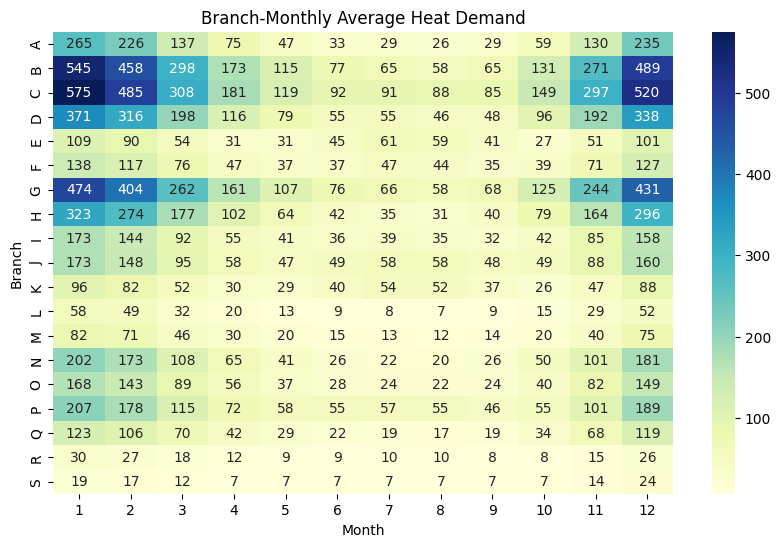

In [66]:
#  브랜치·월별 평균 열수요
pivot = heat.pivot_table(index='branch_id', columns='month', values='heat_demand', aggfunc='mean')
plt.figure(figsize=(10,6))
sns.heatmap(pivot, cmap='YlGnBu', annot=True, fmt=".0f")
plt.title('Branch-Monthly Average Heat Demand')
plt.xlabel('Month')
plt.ylabel('Branch')
plt.show()


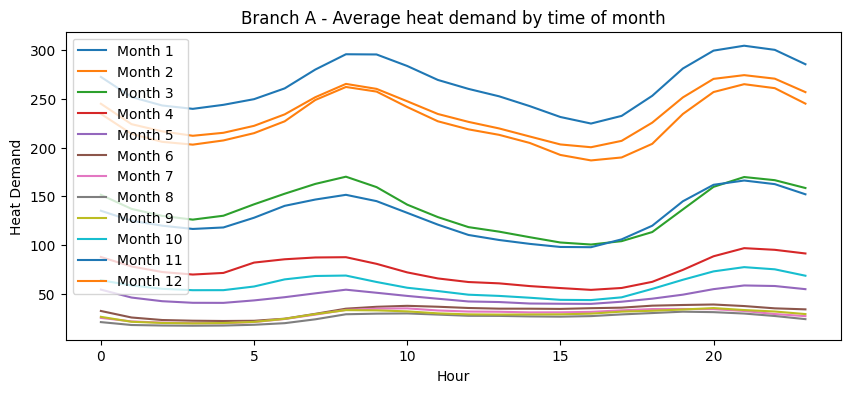

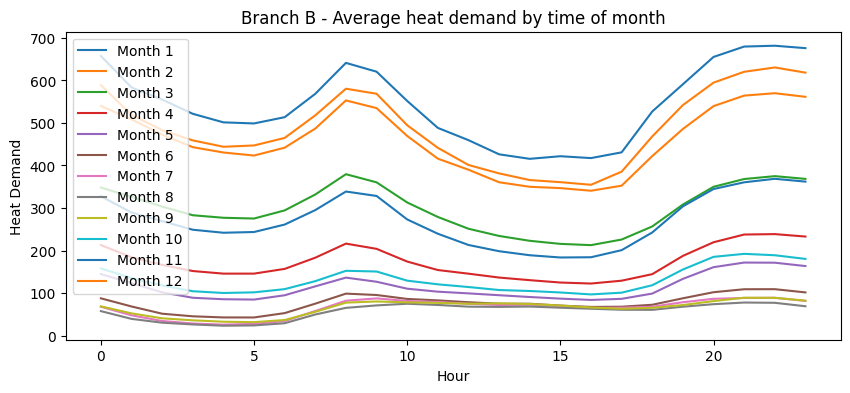

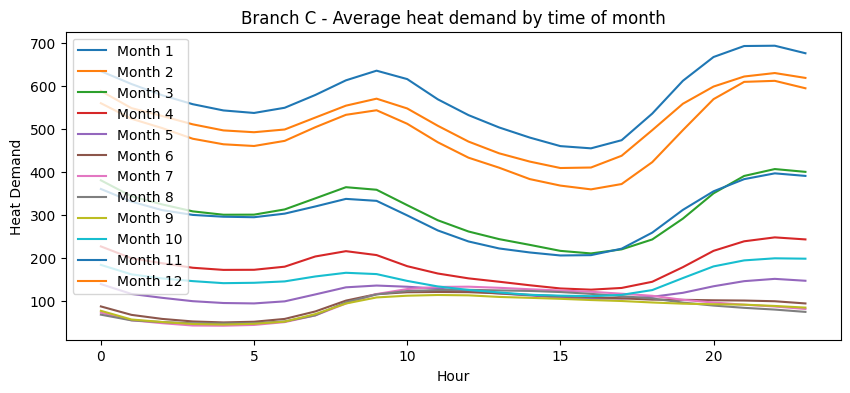

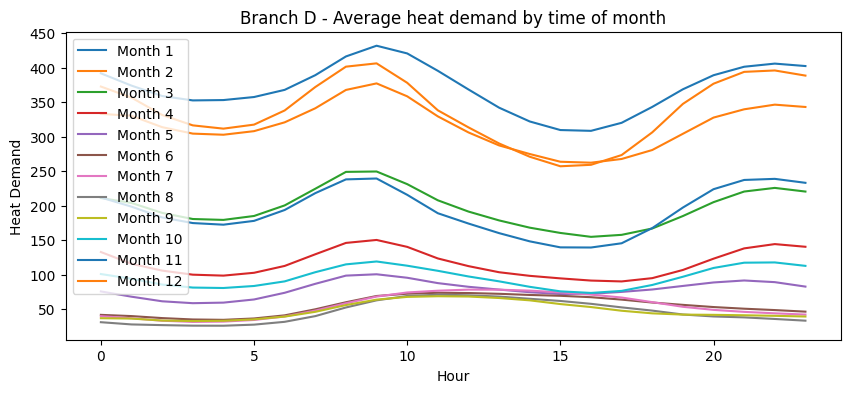

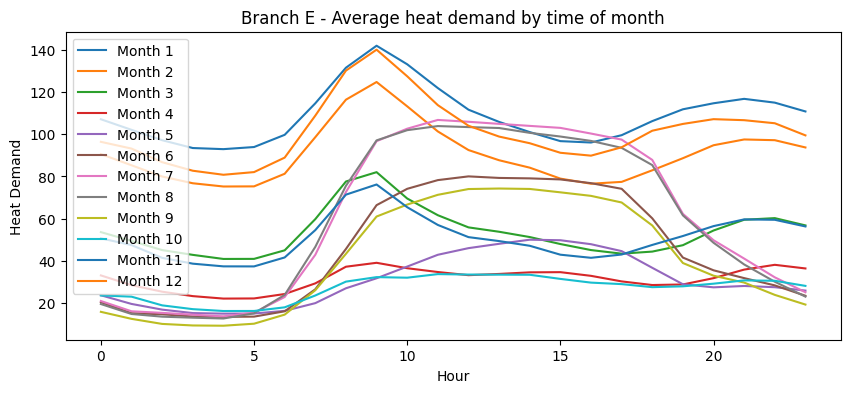

...

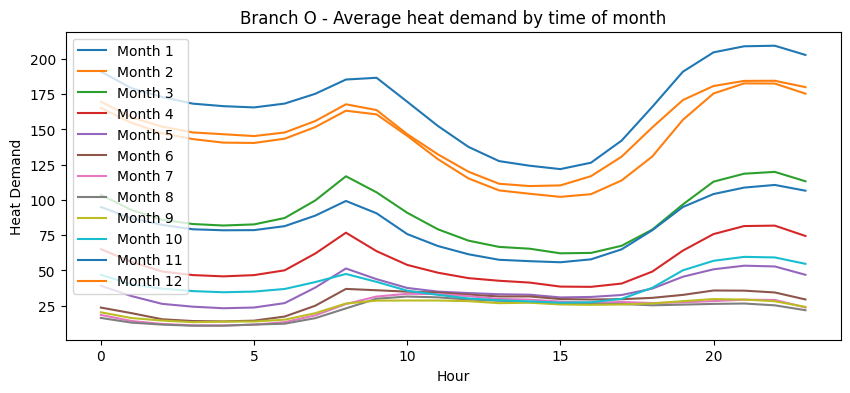

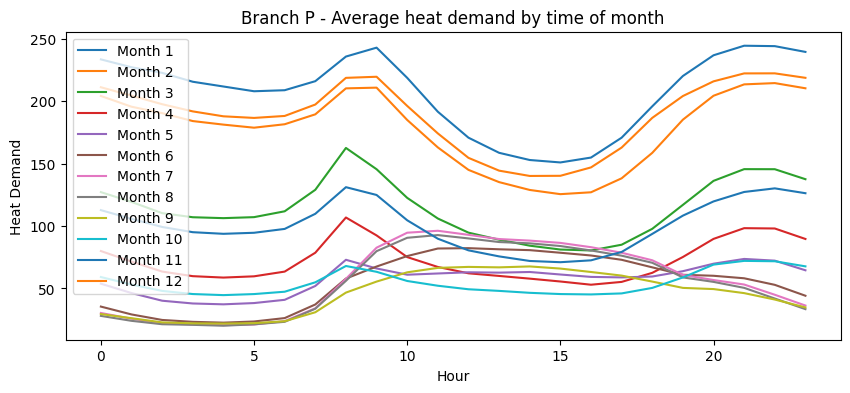

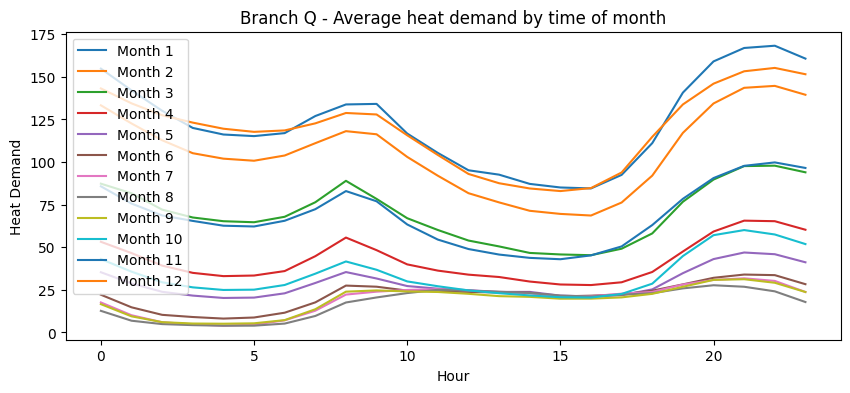

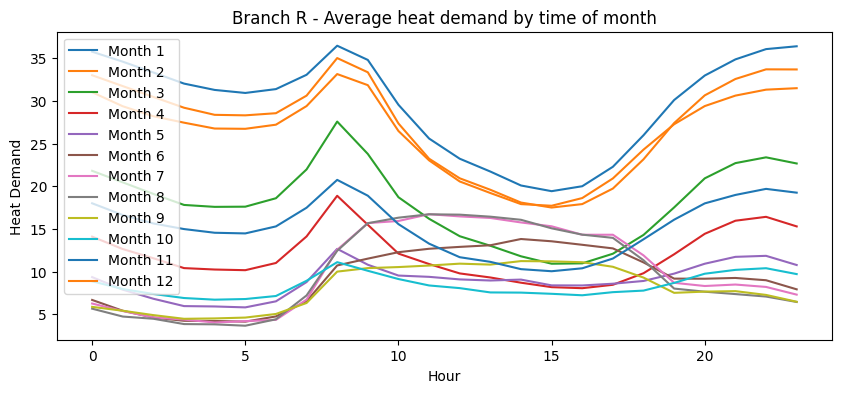

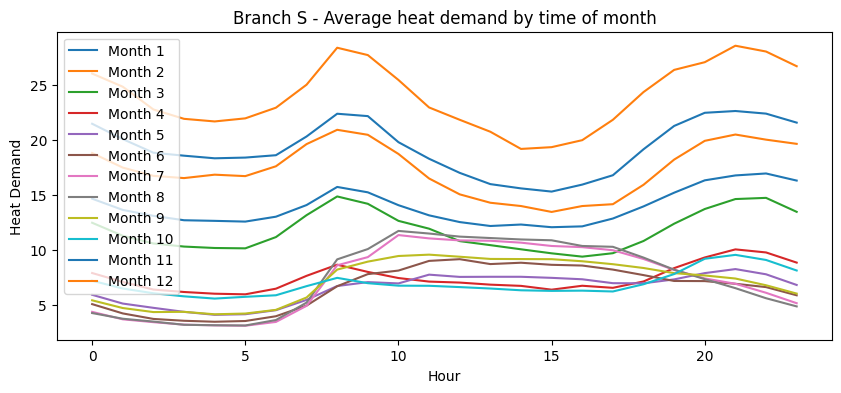

In [67]:
# 브랜치·월·시간별 평균 열수요 (라인플롯)
for b in branches:
    df = heat[heat['branch_id'] == b]
    pivot = df.pivot_table(index='hour', columns='month', values='heat_demand', aggfunc='mean')
    plt.figure(figsize=(10,4))
    for m in pivot.columns:
        plt.plot(pivot.index, pivot[m], label=f'Month {m}')
    plt.title(f'Branch {b} - Average heat demand by time of month')
    plt.xlabel('Hour')
    plt.ylabel('Heat Demand')
    plt.legend()
    plt.show()


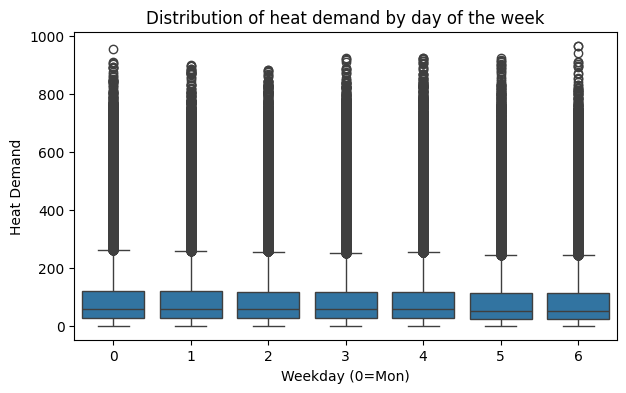

In [68]:
# 요일별 평균 열수요
# 요일 변수 생성 (0=월요일)
heat['weekday'] = pd.to_datetime(heat['tm']).dt.weekday
plt.figure(figsize=(7,4))
sns.boxplot(x='weekday', y='heat_demand', data=heat)
plt.title('Distribution of heat demand by day of the week')
plt.xlabel('Weekday (0=Mon)')
plt.ylabel('Heat Demand')
plt.show()


# 시계열

In [11]:
heat

,tm,branch_id,ta,wd,ws,rn_day,rn_hr1,hm,si,ta_chi,heat_demand,year,month,day,hour
1,2021-01-01 01:00:00,A,-10.1,78.3,0.5,0.0,0.0,68.2,-99.0,-8.2,281,2021,1,1,1
2,2021-01-01 02:00:00,A,-10.2,71.9,0.6,0.0,0.0,69.9,-99.0,-8.6,262,2021,1,1,2
3,2021-01-01 03:00:00,A,-10.0,360.0,0.0,0.0,0.0,69.2,-99.0,-8.8,266,2021,1,1,3
4,2021-01-01 04:00:00,A,-9.3,155.9,0.5,0.0,0.0,65.0,-99.0,-8.9,285,2021,1,1,4
5,2021-01-01 05:00:00,A,-9.0,74.3,1.9,0.0,0.0,63.5,-99.0,-9.2,283,2021,1,1,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
499297,2023-12-31 19:00:00,S,3.2,233.5,0.4,2.5,0.0,91.5,-99.0,2.8,34,2023,12,31,19
499298,2023-12-31 20:00:00,S,2.9,227.4,0.1,2.5,0.0,92.1,-99.0,2.7,35,2023,12,31,20
499299,2023-12-31 21:00:00,S,2.1,360.0,0.0,2.5,0.0,93.3,-99.0,1.4,35,2023,12,31,21
499300,2023-12-31 22:00:00,S,2.2,30.0,1.4,2.5,0.0,95.5,-99.0,1.3,40,2023,12,31,22


In [12]:
# 1, 2, 3, 24시간 시차(lag) 변수
heat['heat_demand_lag1'] = heat['heat_demand'].shift(1)
heat['heat_demand_lag2'] = heat['heat_demand'].shift(2)
heat['heat_demand_lag3'] = heat['heat_demand'].shift(3)
heat['heat_demand_lag24'] = heat['heat_demand'].shift(24)

# 3, 6, 24시간 이동평균(MA) 변수
heat['heat_demand_ma3'] = heat['heat_demand'].rolling(window=3).mean()
heat['heat_demand_ma6'] = heat['heat_demand'].rolling(window=6).mean()
heat['heat_demand_ma24'] = heat['heat_demand'].rolling(window=24).mean()


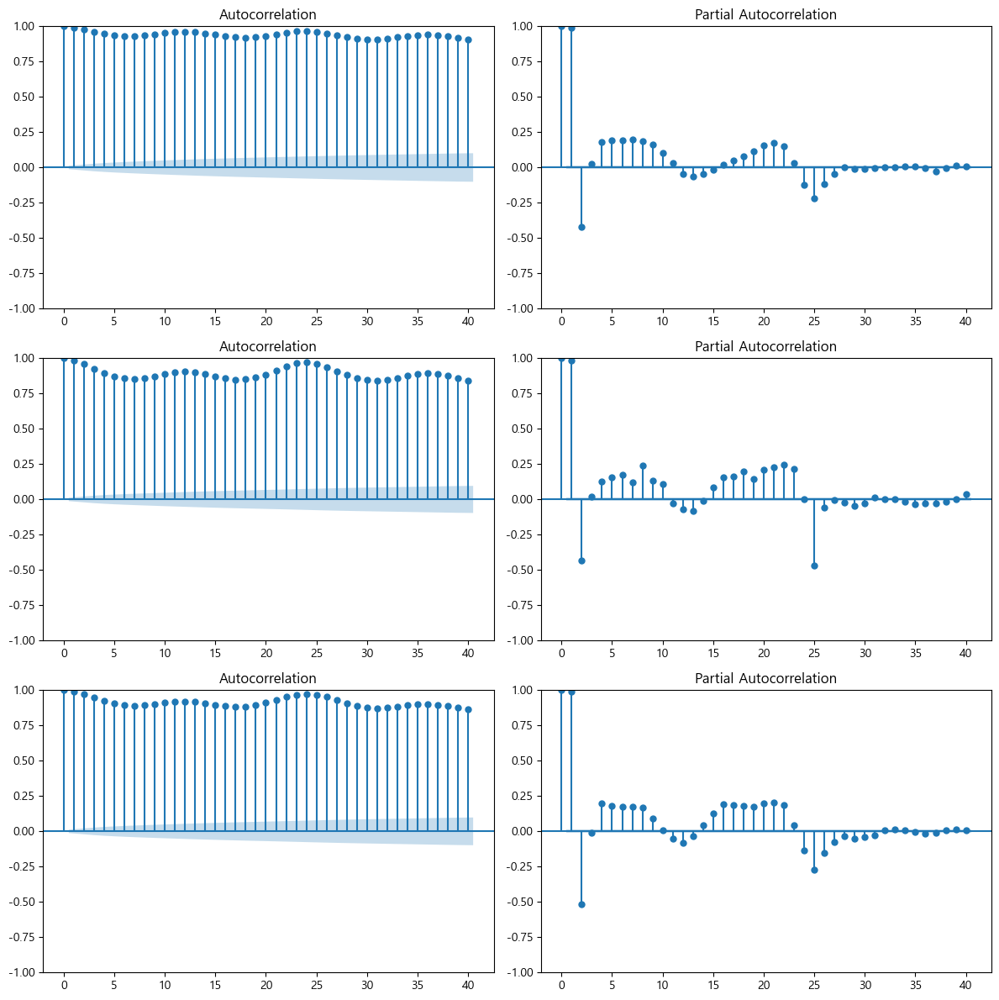

In [12]:
import matplotlib.pyplot as plt
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

branches = heat['branch_id'].unique()

fig, axes = plt.subplots(len(branches[:3]), 2, figsize=(12, 4*len(branches[:3])))

for i, branch in enumerate(branches[:3]):
    data = heat.loc[heat['branch_id'] == branch, 'heat_demand'].dropna()
    axes[i, 0].set_title(f'Branch {branch} ACF')
    plot_acf(data, lags=40, ax=axes[i, 0])
    axes[i, 1].set_title(f'Branch {branch} PACF')
    plot_pacf(data, lags=40, ax=axes[i, 1])

plt.tight_layout()
plt.show()


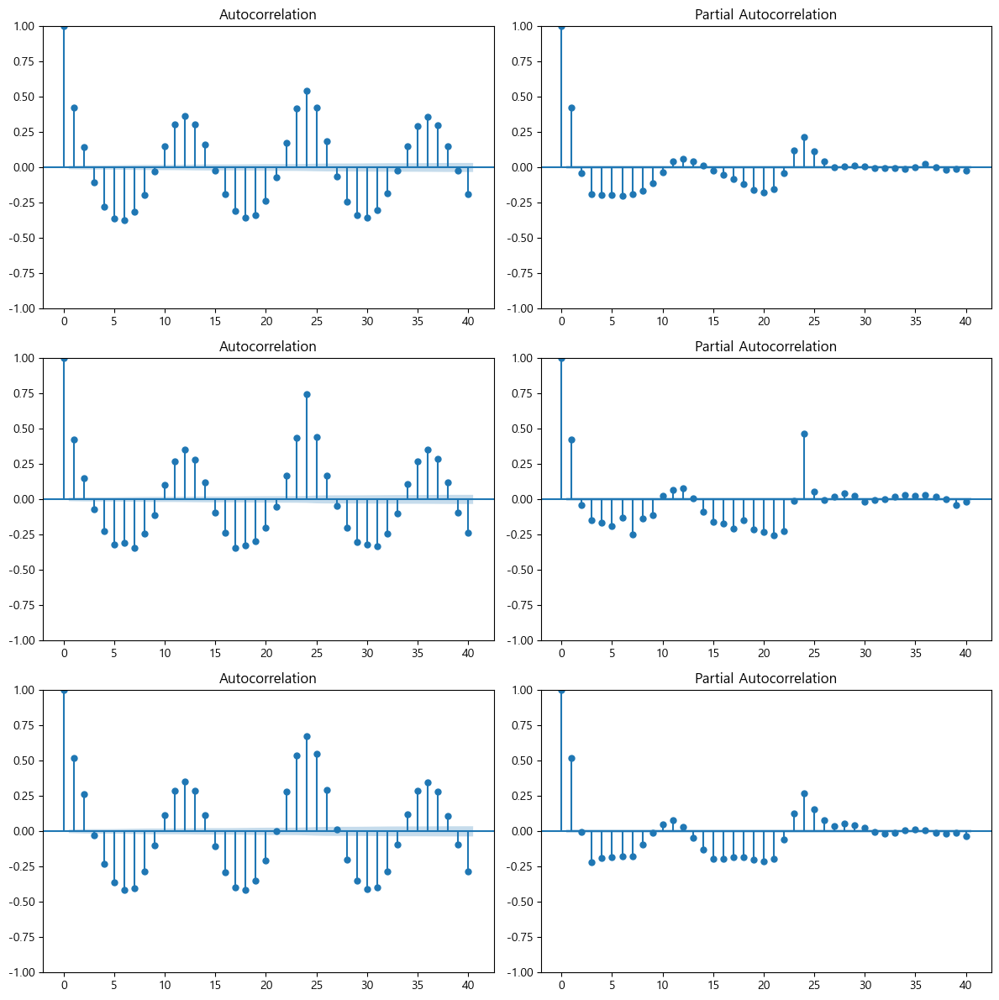

In [14]:
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

branches = heat['branch_id'].unique() 

fig, axes = plt.subplots(len(branches[:3]), 2, figsize=(12, 4*len(branches[:3])))

for i, branch in enumerate(branches[:3]):
    data = heat.loc[heat['branch_id'] == branch, 'heat_demand'].dropna()
    diff_data = data.diff().dropna()  # 1차 차분
    
    axes[i, 0].set_title(f'Branch {branch} 1차 차분 ACF')
    plot_acf(diff_data, lags=40, ax=axes[i, 0])
    axes[i, 1].set_title(f'Branch {branch} 1차 차분 PACF')
    plot_pacf(diff_data, lags=40, ax=axes[i, 1])

plt.tight_layout()
plt.show()


# 클러스터별 EDA

In [29]:
cluster_0 = ['E', 'F', 'I', 'J', 'K', 'N', 'O', 'Q']
cluster_1 = ['B', 'C', 'G']
cluster_2 = ['A', 'D', 'H', 'P']
cluster_3 = ['L', 'M', 'R', 'S']

# branch_id별 클러스터 매핑 딕셔너리 생성
cluster_map = {}
for b in cluster_0:
    cluster_map[b] = 0
for b in cluster_1:
    cluster_map[b] = 1
for b in cluster_2:
    cluster_map[b] = 2
for b in cluster_3:
    cluster_map[b] = 3

# cluster 변수 추가
heat['cluster'] = heat['branch_id'].map(cluster_map)

In [30]:
heat

,tm,branch_id,ta,wd,ws,rn_day,rn_hr1,hm,si,ta_chi,heat_demand,year,month,day,hour,cluster
1,2021-01-01 01:00:00,A,-10.1,78.3,0.5,0.0,0.0,68.2,NaN,-8.2,281.0,2021,1,1,1,2
2,2021-01-01 02:00:00,A,-10.2,71.9,0.6,0.0,0.0,69.9,NaN,-8.6,262.0,2021,1,1,2,2
3,2021-01-01 03:00:00,A,-10.0,360.0,0.0,0.0,0.0,69.2,NaN,-8.8,266.0,2021,1,1,3,2
4,2021-01-01 04:00:00,A,-9.3,155.9,0.5,0.0,0.0,65.0,NaN,-8.9,285.0,2021,1,1,4,2
5,2021-01-01 05:00:00,A,-9.0,74.3,1.9,0.0,0.0,63.5,NaN,-9.2,283.0,2021,1,1,5,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
499297,2023-12-31 19:00:00,S,3.2,233.5,0.4,2.5,0.0,91.5,NaN,2.8,34.0,2023,12,31,19,3
499298,2023-12-31 20:00:00,S,2.9,227.4,0.1,2.5,0.0,92.1,NaN,2.7,35.0,2023,12,31,20,3
499299,2023-12-31 21:00:00,S,2.1,360.0,0.0,2.5,0.0,93.3,NaN,1.4,35.0,2023,12,31,21,3
499300,2023-12-31 22:00:00,S,2.2,30.0,1.4,2.5,0.0,95.5,NaN,1.3,40.0,2023,12,31,22,3


In [31]:
# si 결측치 채우기
 
# A,B,C,F
common_night_rules_1 = [
    ((1, 1), (2, 6), 19, 7),
    ((2, 6), (3, 4), 20, 7),
    ((3, 4), (4, 7), 20, 6),
    ((4, 7), (4, 13), 21, 6),
    ((4, 13), (8, 28), 21, 5),
    ((8, 28), (9, 3), 21, 6),
    ((9, 3), (10, 12), 20, 6),
    ((10, 12), (11, 3), 19, 6),
    ((11, 3), (12, 31), 19, 7)
]

# D,E,G,H,I,J,K,S
common_night_rules_2 = [
    ((1, 1), (2, 5), 19, 7),
    ((2, 5), (3, 4), 20, 7),
    ((3, 4), (4, 7), 20, 6),
    ((4, 7), (4, 14), 21, 6),
    ((4, 14), (8, 28), 21, 5),
    ((8, 28), (9, 3), 21, 6),
    ((9, 3), (10, 13), 20, 6),
    ((10, 13), (11, 4), 19, 6),
    ((11, 4), (12, 31), 19, 7)
]

# L,M,N
common_night_rules_3 = [
    ((1, 1), (2, 10), 19, 7),
    ((2, 10), (2, 25), 20, 7),
    ((2, 25), (4, 9), 20, 6),
    ((4, 9), (4, 19), 20, 5),
    ((4, 19), (8, 26), 21, 5),
    ((8, 26), (9, 4), 20, 5),
    ((9, 4), (10, 7), 20, 6),
    ((10, 7), (11, 13), 19, 6),
    ((11, 13), (12, 31), 19, 7)
]

# O
common_night_rules_4 = [
    ((1, 1), (2, 6), 19, 7),
    ((2, 6), (3, 2), 20, 7),
    ((3, 2), (4, 11), 20, 6),
    ((4, 11), (4, 13), 21, 6),
    ((4, 13), (8,30), 21, 5),
    ((8, 30), (9, 1), 21, 6),
    ((9, 1), (10, 11), 20, 6),
    ((10, 11), (11, 7), 19, 6),
    ((11, 7), (12, 31), 19, 7)
]

# P
common_night_rules_5 = [
    ((1, 1), (2, 6), 19, 7),
    ((2, 6), (3, 3), 20, 7),
    ((3, 3), (4, 10), 20, 6),
    ((4, 10), (4, 13), 21, 6),
    ((4, 13), (8,30), 21, 5),
    ((8, 30), (9, 2), 21, 6),
    ((9, 2), (10, 12), 20, 6),
    ((10, 12), (11, 6), 19, 6),
    ((11, 6), (12, 31), 19, 7)
]

# Q
common_night_rules_6 = [
    ((1, 1), (2, 5), 19, 7),
    ((2, 5), (3, 5), 20, 7),
    ((3, 5), (4, 7), 20, 6),
    ((4, 7), (4, 14), 21, 6),
    ((4, 14), (8, 28), 21, 5),
    ((8, 28), (9, 3), 21, 6),
    ((9, 3), (10, 13), 20, 6),
    ((10, 13), (11, 2), 19, 6),
    ((11, 2), (12, 31), 19, 7)
]

# R
common_night_rules_7 = [
    ((1, 1), (2, 1), 19, 7),
    ((2, 1), (3, 2), 20, 7),
    ((3, 2), (4, 9), 20, 6),
    ((4, 9), (4, 15), 21, 6),
    ((4, 15), (8, 26), 21, 5),
    ((8, 26), (9, 2), 21, 6),
    ((9, 2), (10, 14), 20, 6),
    ((10, 14), (11, 8), 19, 6),
    ((11, 8), (12, 31), 19, 7)
]


# 브랜치별 야간 시간 규칙 딕셔너리
branch_night_rules = {
    'A': common_night_rules_1,
    'B': common_night_rules_1,
    'C': common_night_rules_1,
    'D': common_night_rules_2,
    'E': common_night_rules_2,
    'F': common_night_rules_1,
    'G': common_night_rules_2,
    'H': common_night_rules_2,
    'I': common_night_rules_2,
    'J': common_night_rules_2,
    'K': common_night_rules_2,
    'L': common_night_rules_3,
    'M': common_night_rules_3,
    'N': common_night_rules_3,
    'O': common_night_rules_4,
    'P': common_night_rules_5,
    'Q': common_night_rules_6,
    'R': common_night_rules_7,
    'S': common_night_rules_2
}

# 모든 브랜치에 대해 야간 시간 적용
for branch, rules in branch_night_rules.items():
    is_branch = heat['branch_id'] == branch

    for (start_m, start_d), (end_m, end_d), night_start, night_end in rules:
        in_period = (
            ((heat['month'] > start_m) | ((heat['month'] == start_m) & (heat['day'] >= start_d))) &
            ((heat['month'] < end_m) | ((heat['month'] == end_m) & (heat['day'] <= end_d)))
        )

        if night_start > night_end:  # 자정을 넘기는 경우
            in_night = (heat['hour'] >= night_start) | (heat['hour'] <= night_end)
        else:
            in_night = (heat['hour'] >= night_start) & (heat['hour'] < night_end)

        # 조건에 맞는 행에 대해 si 값 0으로 설정
        mask = is_branch & in_period & in_night
        heat.loc[mask, 'si'] = 0


## cluster 2만 보기

In [32]:
heat2 = heat[heat['cluster']==2]
heat2

,tm,branch_id,ta,wd,ws,rn_day,rn_hr1,hm,si,ta_chi,heat_demand,year,month,day,hour,cluster
1,2021-01-01 01:00:00,A,-10.1,78.3,0.5,0.0,0.0,68.2,0.0,-8.2,281.0,2021,1,1,1,2
2,2021-01-01 02:00:00,A,-10.2,71.9,0.6,0.0,0.0,69.9,0.0,-8.6,262.0,2021,1,1,2,2
3,2021-01-01 03:00:00,A,-10.0,360.0,0.0,0.0,0.0,69.2,0.0,-8.8,266.0,2021,1,1,3,2
4,2021-01-01 04:00:00,A,-9.3,155.9,0.5,0.0,0.0,65.0,0.0,-8.9,285.0,2021,1,1,4,2
5,2021-01-01 05:00:00,A,-9.0,74.3,1.9,0.0,0.0,63.5,0.0,-9.2,283.0,2021,1,1,5,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
420460,2023-12-31 19:00:00,P,3.5,272.7,1.4,1.6,0.0,81.2,0.0,3.4,194.0,2023,12,31,19,2
420461,2023-12-31 20:00:00,P,3.3,198.9,0.8,1.6,0.0,84.6,0.0,3.2,199.0,2023,12,31,20,2
420462,2023-12-31 21:00:00,P,3.1,286.1,0.5,1.6,0.0,85.2,0.0,3.0,200.0,2023,12,31,21,2
420463,2023-12-31 22:00:00,P,3.0,194.3,0.4,1.6,0.0,87.2,0.0,2.7,194.0,2023,12,31,22,2


In [33]:
heat2.isnull().sum()

tm                0
branch_id         0
ta             3886
wd             6164
ws             6164
rn_day         5560
rn_hr1         5688
hm             8013
si             9874
ta_chi            1
heat_demand       4
year              0
month             0
day               0
hour              0
cluster           0
dtype: int64

In [34]:
heat2.isnull().mean()

tm             0.000000
branch_id      0.000000
ta             0.036969
wd             0.058640
ws             0.058640
rn_day         0.052894
rn_hr1         0.054112
hm             0.076230
si             0.093934
ta_chi         0.000010
heat_demand    0.000038
year           0.000000
month          0.000000
day            0.000000
hour           0.000000
cluster        0.000000
dtype: float64

In [38]:
heat['heat_demand'].dropna(inplace=True)

<Axes: >

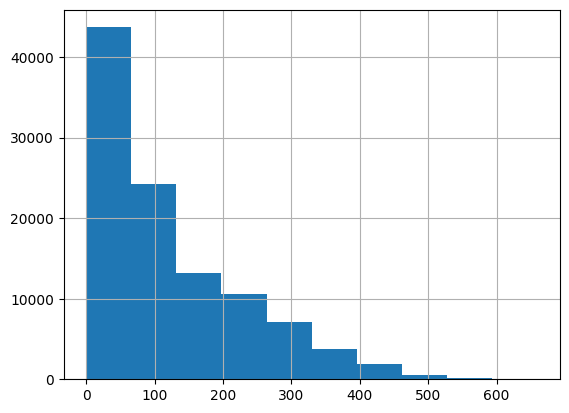

In [ ]:
heat['']